<table style="width: 100%; height:auto; border-collapse: collapse;">
  <tr>
    <td style="width: 40%; text-align: left;">
      <img src="./img/uni_facultad.png" alt="Logo de la Universidad" style="width: 400px; height: auto;">
    </td>
    <td style="width: 30%; text-align: center; font-size: 18px;">
      <strong>Diego Alberto Rodríguez Cruz</strong>
    </td>
    <td style="width: 40%; text-align: right; font-size: 18px;">
        <strong>
      MINE-4101: Ciencia de Datos Aplicada<br>
      Quiz 003
        </strong>
    </td>
  </tr>
</table>


# Quiz 

## Contexto 
El mercado inmobiliario Colombiano representa más del 20% del PIB del país, siendo parte integral de la economía, proporcionando empleos a través de la construcción y moviendo cantidades de dinero de órdenes significativo en compraventa de propiedades y servicios de alquiler.

HabitAlpes es una startup Colombiana que está armando un portafolio de servicios de consultoría para los propietarios de vivienda y para el gobierno distrital. Entre sus diferentes proyectos se encuentran el soporte para avalúo de los precios de vivienda, la compra, remodelación y reventa de propiedades en la capital del país, consultoría y elaboración de contratos de arrendamiento, correcciones de avalúos catastrales e informes de sugerencia de reclasificación de estratos en barrios de diferentes localidades de la ciudad. Adicionalmente, la empresa busca ser efectiva al momento de ofrecer a sus clientes el portafolios de servicios más conveniente según sus necesidades.

Es por esto que HabitAlpes le ha contratado para que, usando herramientas de Machine Learning e Inteligencia de Negocios, usted participe en la implementación de uno de sus servicios. En particular, HabitAlpes quiere comenzar con la construcción de una herramienta de cálculo de precio de venta para apartamentos de la ciudad, de tal manera que sus clientes puedan ingresar la información de sus respectivos apartamentos y obtener un valor estimado sugerido que esté de acuerdo con las características y ubicación del mismo, y en línea con los precios de venta de propiedades similares en el sector que le permitan ser competitivos. Para comenzar, la empresa ha recopilado una muestra de la información de apartamentos en el mercado de los últimos dos meses, que servirá como su insumo para la construcción de una prueba de concepto de la herramienta (ver Semana 9 del curso).

Adicionalmente, usted sabe que el proceso de compra requiere la inversión de 6 horas de un perito (salario por hora: $9.500) que revise los datos y genere un precio. Con un algoritmo de Machine Learning capaz de estimar de forma precisa los montos, se estima que se reducirá el tiempo del experto a 1 hora únicamente. HabitAlpes es capaz de revisar hasta 500 apartamentos al mes. Según datos históricos, se prevé que por cada estimación por debajo de 20 millones del valor del apartamento, el cliente solicitará un avalúo presencial. 

### Dataset

Se utiliza la información del archivo *apartamentos.csv*, cuyo diccionario de datos:

Columna|Descripción
-|-
_id|Identificador
codigo|Código único que identifica cada apartamento
tipo_propiedad|Tipo de propiedad (apartamento, casa, etc.)
tipo_operacion|Tipo de operación (venta, arriendo, etc.)
precio_venta|Precio de venta del apartamento COP
precio_arriendo|Precio de arriendo del apartamento COP
area|Área del apartamento en metros cuadrados
habitaciones|Número de habitaciones del apartamento
banos|Número de baños del apartamento
administracion|Valor de la cuota de administración del apartamento
parqueaderos|Número de parqueaderos disponibles
sector|Sector o zona en la que se encuentra el apartamento
estrato|Estrato socioeconómico del apartamento
antiguedad|Antigüedad del apartamento en años
estado|Estado del apartamento (nuevo, usado)
longitud|Longitud geográfica del apartamento
latitud|Latitud geográfica del apartamento
descripcion|Descripción detallada del apartamento
datetime|Fecha y hora de extracción de los datos
jacuzzi|Indica si el apartamento cuenta con jacuzzi
piscina|Indica si el apartamento cuenta con piscina
salon_comunal|Indica si el apartamento cuenta con salón comunal
terraza|Indica si el apartamento cuenta con terraza
vigilancia|Indica si el apartamento cuenta con vigilancia privada
piso|Número de piso en el que se encuentra el apartamento
closets|Número de closets en el apartamento
chimenea|Indica si el apartamento cuenta con chimenea
permite_mascotas|Indica si se permiten mascotas en el apartamento
gimnasio|Indica si el apartamento cuenta con gimnasio
ascensor|Indica si el edificio cuenta con ascensor
conjunto_cerrado|Indica si el apartamento se encuentra en conjunto cerrado
coords_modified|Coordenadas modificadas del apartamento
localidad|Localidad en la que se encuentra el apartamento
barrio|Barrio en el que se encuentra el apartamento
estacion_tm_cercana|Nombre de la estacion de transporte masivo mas cercana
distancia_estacion_tm_m|Distancia a la estación de transporte masivo más cercana
is_cerca_estacion_tm|Indica si está cerca de una estación de transporte masivo <= 500m
parque_cercano|Nombre del parque más cercano al apartamento
distancia_parque_m|Distancia al parque más cercano al apartamento en metros
is_cerca_parque|Indica si está cerca de un parque <= 500m
website|Sitio web relacionado a la propiedad
compañia|Compañía o agencia responsable de la propiedad
last_view|Fecha de la ultima vez que el scraper visito el apartamento
timeline|Historial de precios del apartamento
url|URL del apartamento

## Indice 
* [Carga de datos](#Carga-de-datos)
* [Selección atributos](#Seleccion-atributos)
* [Análisis Univariado](#Analisis-Univariado)
* [Análisis Bivariado](#Analisis-Bivariado)
* [Análisis Multivariado](#Analisis-Multivariado)
* [Modelo](#Modelo)
* [Curva ROC](#Curva-ROC)

## Librerías

In [7]:
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from matplotlib.ticker import FuncFormatter, FormatStrFormatter
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import ast
import csv

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression,LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score,roc_curve, auc

from ydata_profiling import ProfileReport

import scipy.stats as stats

In [8]:
# configuración
warnings.filterwarnings('ignore')

pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 100)
pd.set_option('display.max_colwidth', 128)
pd.set_option('display.float_format', '{:.2f}'.format)
np.set_printoptions(precision=2, suppress=True)

In [9]:
# Función para formatear a dos decimales
def decimal_formatter(x, _):
    return f"{x:,.2f}" 

## Carga de datos
([Volver al inicio](#Indice))

Al revisar los datos del archivo, se evidencia que existen registros que continuan en varias líneas la información de un solo registro, lo cual puede llegar a afectar la carga de los datos, es el ejemplo para el registro cuyo código es `2671-M5148439` y el cual presenta los datos de esta forma:

No. Línea en el archivo | Datos presentados
|----|-------------|
42800 | 66d86eafceda690e85512cd8,2671-M5148439,APARTAMENTO,VENTA,2850000000,201.0,3,4,1990000,3,CHICO,6,ENTRE 5 Y 10 ANOS,4.67499,-74.05037,NaN,"este apartamento se caracteriza por su diseno, acabados modernos de alta gama, techos altos, excelente distribucion, vista y luz natural. ubicado en uno de los mejores edificios de la zona. al ingresar por el ascensor directo, encontramos una amplia zona social que consta de sala - comedor con acceso al balcon, estudio y bano social.
42801 | la cocina moderna y funcional cuenta con electrodomesticos de alta gama, esta integrada a la zona social y se puede independizar mediante una puerta corrediza, tiene acceso a la zona de lavanderia y bano de servicio.
42802 | en la zona privada encontramos un family room y tres habitaciones, todas con bano en suite, la principal con walk-in closet. el apartamento se complementa con tres garajes independientes y un deposito. el edificio tiene un impactante lobby, terraza, zonas verdes, gimnasio, salon para conductores, business center y salon social.",metrocuadrado.com,2024-08-19 01:30:10.468,2024-08-19 01:30:10.468,NaN,NaN,USADO,ENGEL & VOLKERS,NaN,0,NaN,NaN,0,0,1,1,0,0,0,0,0,False,CHAPINERO,S.C. CHICO NORTE,Virrey,964.28,0,PARQUE ZONAL CANAL EL VIRREY EL CHICO,424.76,1


Por lo anterior, se ha de realizar una limpieza al archivo original con el fin de evitar perdida de información

In [11]:
# Se realiza un conteo de registros del archivo original
with open('./data/apartamentos.csv', 'r', encoding='utf-8') as f:
    lineas = sum(1 for _ in f)
print(f'Número total de líneas en el archivo "apartamentos.csv": {lineas}')

Número total de líneas en el archivo "apartamentos.csv": 43471


In [12]:
# se crea un archivo nuevo con base al original, solventando los saltos de línea para un mismo registro
with open('./data/apartamentos.csv', 'r', encoding='utf-8') as infile, open('./data/apartamentos_limpio.csv', 'w', encoding='utf-8', newline='') as outfile:
    reader = csv.reader(infile)
    writer = csv.writer(outfile)
    
    for row in reader:      
        for i in range(len(row)):
            row[i] = row[i].replace('\n', ' ')  # Reemplazar saltos de línea por espacio
        writer.writerow(row)

In [13]:
# Se realiza un conteo de registros en el nuevo archivo 
with open('./data/apartamentos_limpio.csv', 'r', encoding='utf-8') as f:
    lineas = sum(1 for _ in f)
print(f'Número total de líneas en el archivo "apartamentos_limpio.csv": {lineas}')

Número total de líneas en el archivo "apartamentos_limpio.csv": 43014


In [14]:
# carga de dataset con la limpieza realizada
aptos_df = pd.read_csv("./data/apartamentos_limpio.csv", delimiter=',', encoding='utf-8')

In [15]:
# dimension del dataset
print(f'Dimensiones del dataset: {aptos_df.shape[0]} registros, {aptos_df.shape[1]} columnas')

Dimensiones del dataset: 43013 registros, 46 columnas


In [16]:
# tipos de datos de las columnas del dataset
aptos_df.dtypes

_id                         object
codigo                      object
tipo_propiedad              object
tipo_operacion              object
precio_venta               float64
area                       float64
habitaciones               float64
banos                      float64
administracion             float64
parqueaderos               float64
sector                      object
estrato                    float64
antiguedad                  object
latitud                    float64
longitud                   float64
direccion                   object
descripcion                 object
website                     object
last_view                   object
datetime                    object
url                         object
timeline                    object
estado                      object
compañia                    object
precio_arriendo            float64
jacuzzi                    float64
piso                       float64
closets                    float64
chimenea            

In [17]:
# filtrar un registro especifico
aptos_df[aptos_df['codigo']=='2671-M5148439']

,_id,codigo,tipo_propiedad,tipo_operacion,precio_venta,area,habitaciones,banos,administracion,parqueaderos,sector,estrato,antiguedad,latitud,longitud,direccion,descripcion,website,last_view,datetime,url,timeline,estado,compañia,precio_arriendo,jacuzzi,piso,closets,chimenea,permite_mascotas,gimnasio,ascensor,conjunto_cerrado,piscina,salon_comunal,terraza,vigilancia,coords_modified,localidad,barrio,estacion_tm_cercana,distancia_estacion_tm_m,is_cerca_estacion_tm,parque_cercano,distancia_parque_m,is_cerca_parque
42360,66d86eafceda690e85512cd8,2671-M5148439,APARTAMENTO,VENTA,2850000000.00,201.00,3.00,4.00,1990000.00,3.00,CHICO,6.00,ENTRE 5 Y 10 ANOS,4.67,-74.05,NaN,"este apartamento se caracteriza por su diseno, acabados modernos de alta gama, techos altos, excelente distribucion, vista y...",metrocuadrado.com,2024-08-19 01:30:10.468,2024-08-19 01:30:10.468,NaN,NaN,USADO,ENGEL & VOLKERS,NaN,0.00,NaN,NaN,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,False,CHAPINERO,S.C. CHICO NORTE,Virrey,964.28,0,PARQUE ZONAL CANAL EL VIRREY EL CHICO,424.76,1


In [18]:
# Listar/visualizar 5 registros aleatoriamente
aptos_df.sample(5)

,_id,codigo,tipo_propiedad,tipo_operacion,precio_venta,area,habitaciones,banos,administracion,parqueaderos,sector,estrato,antiguedad,latitud,longitud,direccion,descripcion,website,last_view,datetime,url,timeline,estado,compañia,precio_arriendo,jacuzzi,piso,closets,chimenea,permite_mascotas,gimnasio,ascensor,conjunto_cerrado,piscina,salon_comunal,terraza,vigilancia,coords_modified,localidad,barrio,estacion_tm_cercana,distancia_estacion_tm_m,is_cerca_estacion_tm,parque_cercano,distancia_parque_m,is_cerca_parque
11920,66d86cc2ceda690e8550b5f0,2699-M2502947,APARTAMENTO,VENTA Y ARRIENDO,3700000000.00,325.00,4.00,5.00,2350000.00,3.00,CHICO,6.00,REMODELADO,4.67,-74.04,NaN,fabuloso apto totalmente remodelado con acabados aaa super vista 360 grados conjunto cerrado en un sector super exclusivo,metrocuadrado.com,2024-08-13 14:16:50.644,2024-07-04 11:41:28.461,NaN,[],USADO,CONEXION INMOBILIARIA,18000000.00,0.00,NaN,NaN,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,False,CHAPINERO,S.C. EL BAGAZAL,Héroes,2087.13,0,PARQUE VECINAL URBANIZACIÓN LA CABRERA,1076.71,0
8463,66d86ca7ceda690e8550a86f,2489-M4618968,APARTAMENTO,VENTA,560000000.00,97.00,3.00,3.00,NaN,2.00,SANTA BARBARA,6.00,MAS DE 20 ANOS,4.69,-74.05,NaN,"el edificio cuenta con un salon social, vigilancia 24 horas. edificio muy bien mantenido y conservado. antiguedad del edific...",metrocuadrado.com,2024-07-07 20:06:59.437,2024-07-04 08:15:35.379,NaN,[],USADO,PACTOS SAS,NaN,0.00,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,False,USAQUEN,RINCON DEL CHICO,Calle 100 - Marketmedios,1371.40,0,PARQUE ZONAL CANAL EL VIRREY EL CHICO,1642.10,0
21010,66d86d26ceda690e8550d972,16392-M5042003,APARTAMENTO,VENTA,506000000.00,61.00,2.00,2.00,529200.00,1.00,NIZA ALHAMBRA,5.00,ENTRE 5 Y 10 ANOS,4.70,-74.08,NaN,"apartamento en venta de 61m2, con vista exterior, ubicado en un 10mo piso, torre unica (apto 1002), acceso por ascensor, par...",metrocuadrado.com,2024-08-13 20:20:31.553,2024-07-07 14:20:29.729,NaN,[],USADO,CLEMENTINA ALDANA TORRES,NaN,0.00,NaN,NaN,0.00,0.00,1.00,1.00,1.00,0.00,0.00,0.00,1.00,True,SUBA,NIZA SUR,Humedal Córdoba,854.99,0,PARQUE ZONAL MORATO,883.67,0
41553,66d86e9dceda690e855129b1,12511-M5074360,APARTAMENTO,VENTA,1250000000.00,131.00,2.00,4.00,950000.00,2.00,CHICO,6.00,ENTRE 5 Y 10 ANOS,4.68,-74.05,NaN,se vende espectacular apartamento exterior en chico norte de 131 metros . remodelado muy lindo con excelentes acabados y muy...,metrocuadrado.com,2024-08-18 16:08:09.888,2024-08-18 16:08:09.888,NaN,NaN,USADO,ISABEL URBANEJA REALTOR,NaN,0.00,NaN,NaN,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,False,CHAPINERO,S.C. CHICO NORTE,Virrey,677.61,0,PARQUE VECINAL URBANIZACIÓN NORMANDIA I II II Y IV SECTOR,561.63,0
14254,66d86cd8ceda690e8550bf0e,4-M4753090,APARTAMENTO,ARRIENDO,NaN,95.00,3.00,3.00,657300.00,2.00,COUNTRY,5.00,MAS DE 20 ANOS,4.71,-74.03,NaN,"apartamento de 95mts vista exterior, tres 3 alcobas, cada una con closet, alcoba principal con bano y vestier, sala comedo...",metrocuadrado.com,2024-08-09 06:44:07.625,2024-07-04 13:31:30.634,NaN,[],USADO,INMOBILIARIA REYCO SAS,2600000.00,0.00,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,False,USAQUEN,BELLA SUIZA,Prado,2468.72,0,PARQUE METROPOLITANO EL COUNTRY,978.24,0


In [19]:
# Estadisticas del dataset
aptos_df.describe(include='all')

,_id,codigo,tipo_propiedad,tipo_operacion,precio_venta,area,habitaciones,banos,administracion,parqueaderos,sector,estrato,antiguedad,latitud,longitud,direccion,descripcion,website,last_view,datetime,url,timeline,estado,compañia,precio_arriendo,jacuzzi,piso,closets,chimenea,permite_mascotas,gimnasio,ascensor,conjunto_cerrado,piscina,salon_comunal,terraza,vigilancia,coords_modified,localidad,barrio,estacion_tm_cercana,distancia_estacion_tm_m,is_cerca_estacion_tm,parque_cercano,distancia_parque_m,is_cerca_parque
count,43013,43013,43013,43013,27584.00,43013.00,43012.00,43012.00,35088.00,43012.00,41372,43012.00,43003,43013.00,43013.00,794,43013,43011,43011,43011,794,29427,42217,38483,15829.00,43011.00,0.00,0.00,43011.00,43011.00,43011.00,43011.00,43011.00,43011.00,43011.00,43011.00,43011.00,43013,43013,42820,43013,43013.00,43013.00,43013,43013.00,43013.00
unique,43013,43013,3,3,NaN,NaN,NaN,NaN,NaN,NaN,103,NaN,8,NaN,NaN,703,40499,2,43011,43011,794,2047,2,880,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,19,1666,146,NaN,NaN,176,NaN,NaN
top,66d86c7eceda690e85508760,4133491,APARTAMENTO,VENTA,NaN,NaN,NaN,NaN,NaN,NaN,CHICO,NaN,MAS DE 20 ANOS,NaN,NaN,CARRERA 116A # 15C-70,"el proyecto agora haus 135 cuenta con una ubicacion privilegiada en el barrio contador, calle 135 # 17a-24, con excelentes v...",metrocuadrado.com,2024-08-13 10:34:47.315,2024-07-03 23:27:30.843,https://habi.co/page-data/venta-apartamentos/16819095321/picadilly---apartamento-venta-britalia-suba/page-data.json,[],USADO,ENGEL & VOLKERS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,USAQUEN,S.C. CHICO NORTE,Calle 127,NaN,NaN,PARQUE METROPOLITANO EL COUNTRY,NaN,NaN
freq,1,1,42943,27270,NaN,NaN,NaN,NaN,NaN,NaN,10674,NaN,14352,NaN,NaN,5,34,42217,1,1,1,27381,41991,1529,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42159,14831,1881,3452,NaN,NaN,6818,NaN,NaN
mean,NaN,NaN,NaN,NaN,2364794142.84,180.03,2.62,2.70,4059551.31,1.66,NaN,4.84,NaN,4.69,-74.06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14569333.96,0.05,NaN,NaN,0.00,0.00,0.30,0.63,0.39,0.09,0.00,0.00,0.59,NaN,NaN,NaN,NaN,1270.52,0.21,NaN,808.88,0.28
std,NaN,NaN,NaN,NaN,55741976390.87,9163.00,0.85,1.20,67816415.12,1.11,NaN,1.24,NaN,0.04,0.03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,287458243.90,0.21,NaN,NaN,0.00,0.00,0.46,0.48,0.49,0.29,0.00,0.03,0.49,NaN,NaN,NaN,NaN,841.81,0.41,NaN,447.80,0.45
min,NaN,NaN,NaN,NaN,1000000.00,0.00,1.00,0.00,1.00,-2.00,NaN,0.00,NaN,4.47,-74.21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100000.00,0.00,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,4.94,0.00,NaN,0.22,0.00
25%,NaN,NaN,NaN,NaN,402900000.00,63.00,2.00,2.00,349000.00,1.00,NaN,4.00,NaN,4.66,-74.07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1800000.00,0.00,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,578.38,0.00,NaN,470.14,0.00
50%,NaN,NaN,NaN,NaN,700000000.00,100.00,3.00,3.00,650000.00,2.00,NaN,5.00,NaN,4.69,-74.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3500000.00,0.00,NaN,NaN,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,NaN,NaN,NaN,NaN,1175.52,0.00,NaN,750.14,0.00
75%,NaN,NaN,NaN,NaN,1330000000.00,174.00,3.00,4.00,1200000.00,2.00,NaN,6.00,NaN,4.71,-74.04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7300000.00,0.00,NaN,NaN,0.00,0.00,1.00,1.00,1.00,0.00,0.00,0.00,1.00,NaN,NaN,NaN,NaN,1707.92,0.00,NaN,1087.73,1.00


In [20]:
# Revisión de duplicados general
aptos_df.duplicated().sum()

0

In [21]:
# Verifica duplicados omitiendo la columna '_id'
duplicados = aptos_df.duplicated(subset=aptos_df.columns.difference(['_id']), keep=False)
duplicados.sum()

0

In [22]:
# Revisón de campos vacíos/nulos y tipo de dato
nulos_y_tipos = pd.DataFrame({
    'nulos': aptos_df.isnull().sum(),
    'tipo_dato': aptos_df.dtypes
})
nulos_y_tipos

,nulos,tipo_dato
_id,0,object
codigo,0,object
tipo_propiedad,0,object
tipo_operacion,0,object
precio_venta,15429,float64
area,0,float64
habitaciones,1,float64
banos,1,float64
administracion,7925,float64
parqueaderos,1,float64


Con lo anterior, dependiendo de la selección de atributos a trabajar, se debe realizar un manejo/imputación de datos vacios/nulos según corresponda

In [24]:
# Creación de análisis
profile = ProfileReport(aptos_df)

In [25]:
# reporte de análisis
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Seleccion atributos
([Volver al inicio](#Indice))

Luego de la carga de dataset, se procede a seleccionar las variables de interes.

Las siguientes son los atributos seleccionadas:
- *precio_venta*
- *area* 
- *habitaciones* 
- *banos*
- *sector*
- *tipo_propiedad*
- *tipo_operacion*
- *parqueaderos*
- *localidad*
- *barrio*
- *is_cerca_estacion_tm*
- *is_cerca_parque*

In [27]:
# Listar valores unicos de area
aptos_df["precio_venta"].unique()

array([3.39e+08, 2.23e+08, 4.41e+08, ..., 1.50e+08, 1.94e+08, 1.21e+08])

In [28]:
# Listar valores unicos de area
aptos_df["area"].unique()

array([ 76.  ,  63.  ,  54.  , ...,  28.15, 111.24,  84.34])

In [29]:
# Listar valores unicos de habitaciones
aptos_df["habitaciones"].unique()

array([ 3.,  2.,  1.,  4.,  6.,  7.,  5., nan])

In [30]:
# Listar valores unicos de banos
aptos_df["banos"].unique()

array([ 2.,  1.,  4.,  3.,  6.,  0.,  5., nan])

In [31]:
# Listar valores unicos
aptos_df["sector"].unique()

array(['BRITALIA', 'SAN CRISTOBAL NORTE', 'LA SABANA', 'TIBABUYES',
       'VERBENAL', 'TINTAL SUR', 'SUBA', 'CHAPINERO', 'GARCES NAVAS',
       'QUINTA PAREDES', 'LOS CEDROS', 'CHICO LAGO', 'CALANDAIMA',
       'BOSA CENTRAL', 'EL RINCON', 'SAGRADO CORAZON', 'CASTILLA',
       'BOYACA REAL', 'CIUDAD USME', 'LOS ALCAZARES', 'APOGEO',
       'EL PRADO', 'MARRUECOS', 'MODELIA', 'BOSA OCCIDENTAL', 'AMERICAS',
       'EL PORVENIR', 'LAS MARGARITAS', 'CARVAJAL', 'SOSIEGO', 'GALERIAS',
       'GRANJAS DE TECHO', 'NIZA', 'ENGATIVA', 'ISMAEL PERDOMO',
       'DANUBIO', 'USAQUEN', 'EL MINUTO DE DIOS', 'ZONA FRANCA',
       'ARBORIZADORA', 'LA ALHAMBRA', 'TIMIZA', 'TOBERIN', 'PATIO BONITO',
       'BOLIVIA', 'LA URIBE', 'CORABASTOS', 'SAN JOSE DE BAVARIA',
       'TINTAL NORTE', 'LAS FERIAS', 'FONTIBON', 'SANTA BARBARA',
       'VENECIA', 'SAN FRANCISCO', 'FONTIBON SAN PABLO',
       'CASA BLANCA SUBA', 'GRAN BRITALIA', 'LOS ANDES', 'BAVARIA',
       'MARCO FIDEL SUAREZ', 'CIUDAD MONTES', 'LA FL

In [32]:
# Listar valores unicos 
aptos_df["tipo_operacion"].unique()

array(['VENTA', 'VENTA Y ARRIENDO', 'ARRIENDO'], dtype=object)

In [33]:
# Listar valores unicos 
aptos_df["parqueaderos"].unique()

array([ 1.,  0.,  2., -2.,  3.,  4., nan, 10., 20., 30.])

In [34]:
# Listar valores unicos 
aptos_df["localidad"].unique()

array(['SUBA', 'USAQUEN', 'LOS MARTIRES', 'BOSA', 'PUENTE ARANDA',
       'ENGATIVA', 'TEUSAQUILLO', 'CHAPINERO', 'KENNEDY', 'SANTA FE',
       'USME', 'BARRIOS UNIDOS', 'RAFAEL URIBE URIBE', 'FONTIBON',
       'SAN CRISTOBAL', 'CIUDAD BOLIVAR', 'TUNJUELITO', 'ANTONIO NARINO',
       'CANDELARIA'], dtype=object)

In [35]:
# Listar valores unicos 
aptos_df["barrio"].unique()

array(['URB. PICADELLY', 'BARRANCAS PERLAS DEL NORTE', 'SAN VICTORINO',
       ..., 'BOSQUE CALDERON TEJADA II SECTOR', 'RINCON DE SAN IGNACIO',
       'CIUDAD KENNEDY ORIENTAL SUPERMANZANA 2'], dtype=object)

In [36]:
# Listar valores unicos 
aptos_df["is_cerca_estacion_tm"].unique()

array([0, 1], dtype=int64)

In [37]:
# Listar valores unicos 
aptos_df["is_cerca_parque"].unique()

array([1, 0], dtype=int64)

In [38]:
# Selección de atributos relevantes
selected_columns = ['precio_venta',
                    'area', 
                    'habitaciones', 
                    'banos', 
                    'sector',
                    'tipo_propiedad',
                    'tipo_operacion',
                    'parqueaderos',
                    'localidad',
                    'barrio',
                    'is_cerca_estacion_tm',
                    'is_cerca_parque'
                   ]
df_selected1 = aptos_df[selected_columns]

In [39]:
# Mostrar información Atributos seleccionados
df_selected1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43013 entries, 0 to 43012
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   precio_venta          27584 non-null  float64
 1   area                  43013 non-null  float64
 2   habitaciones          43012 non-null  float64
 3   banos                 43012 non-null  float64
 4   sector                41372 non-null  object 
 5   tipo_propiedad        43013 non-null  object 
 6   tipo_operacion        43013 non-null  object 
 7   parqueaderos          43012 non-null  float64
 8   localidad             43013 non-null  object 
 9   barrio                42820 non-null  object 
 10  is_cerca_estacion_tm  43013 non-null  int64  
 11  is_cerca_parque       43013 non-null  int64  
dtypes: float64(5), int64(2), object(5)
memory usage: 3.9+ MB


In [40]:
# Estadísticas descriptivas de los atributos seleccionados
df_selected1.describe()

,precio_venta,area,habitaciones,banos,parqueaderos,is_cerca_estacion_tm,is_cerca_parque
count,27584.00,43013.00,43012.00,43012.00,43012.00,43013.00,43013.00
mean,2364794142.84,180.03,2.62,2.70,1.66,0.21,0.28
std,55741976390.87,9163.00,0.85,1.20,1.11,0.41,0.45
min,1000000.00,0.00,1.00,0.00,-2.00,0.00,0.00
25%,402900000.00,63.00,2.00,2.00,1.00,0.00,0.00
50%,700000000.00,100.00,3.00,3.00,2.00,0.00,0.00
75%,1330000000.00,174.00,3.00,4.00,2.00,0.00,1.00
max,4250000000000.00,1900000.00,7.00,6.00,30.00,1.00,1.00


In [41]:
# Revisón de campos vacíos/nulos y tipo de dato
nulos_y_tipos = pd.DataFrame({
    'nulos': df_selected1.isnull().sum(),
    'tipo_dato': df_selected1.dtypes
})
nulos_y_tipos

,nulos,tipo_dato
precio_venta,15429,float64
area,0,float64
habitaciones,1,float64
banos,1,float64
sector,1641,object
tipo_propiedad,0,object
tipo_operacion,0,object
parqueaderos,1,float64
localidad,0,object
barrio,193,object


Dado que se busca el precio de venta de las propiedades, y existen tipos de operación que son VENTA, VENTA Y ARRIENDO, ARRIENDO; solo se seleccionan aquellas que son diferentes de arriendo

In [43]:
df_selected = df_selected1[df_selected1['tipo_operacion']!='ARRIENDO']

In [44]:
# Listar valores unicos 
df_selected["tipo_operacion"].unique()

array(['VENTA', 'VENTA Y ARRIENDO'], dtype=object)

In [45]:
# Revisón de campos vacíos/nulos y tipo de dato
nulos_y_tipos = pd.DataFrame({
    'nulos': df_selected.isnull().sum(),
    'tipo_dato': df_selected.dtypes
})
nulos_y_tipos

,nulos,tipo_dato
precio_venta,0,float64
area,0,float64
habitaciones,0,float64
banos,0,float64
sector,771,object
tipo_propiedad,0,object
tipo_operacion,0,object
parqueaderos,0,float64
localidad,0,object
barrio,143,object


Con el filtro realizado previamente, se evidencia que ya no existen nulos en varias de las variables a excepción de dos de tipo texto (SECTO, BARRIO), las cuales corresponden a descripciones.

## Analisis Univariado
([Volver al inicio](#Indice))

Analizar cada atributo de manera individual nos ayuda a entender su distribución y detectar posibles valores atípicos o patrones que puedan influir en la ocupación y rentabilidad de las propiedades

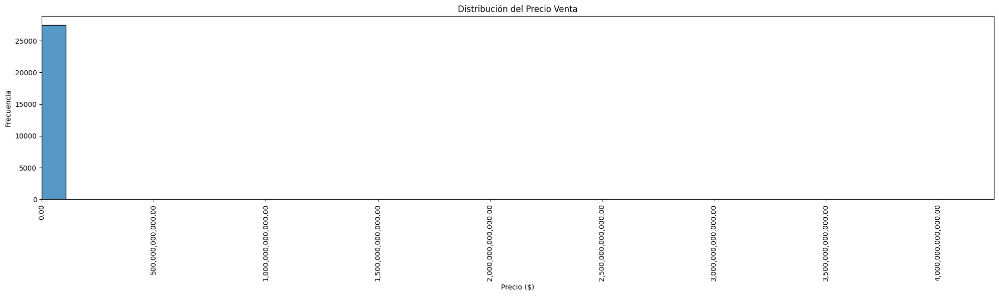

In [49]:
# Gráfico de distribución para el precio
plt.figure(figsize=(20, 6))
sns.histplot(df_selected['precio_venta'], bins=40)
plt.title('Distribución del Precio Venta')
plt.xlabel('Precio ($)')
plt.ylabel('Frecuencia')
plt.xlim(0, df_selected['precio_venta'].max()) # Se fijan lo límites del eje X, Límite inferior 0, límite superior el máximo valor de los datos
plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter)) # formatear la salida de números
plt.xticks(rotation=90)  # Rotar las etiquetas 
# Ajustar el diseño del gráfico
plt.tight_layout()
plt.show()

Lo anterior, permite entender el rango tipico de precios de venta. 
Se evidencia que la gran mayoría de precio_venta son valores inferiores a los 1'000.000.000.000 millones.

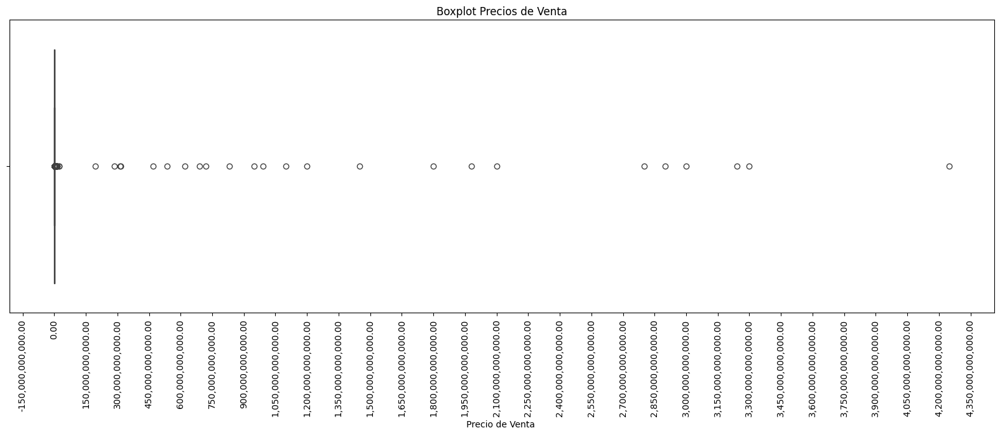

In [51]:
# Boxplot
plt.figure(figsize=(20, 6))
sns.boxplot(data=df_selected, x='precio_venta')
plt.title('Boxplot Precios de Venta')
plt.xlabel('Precio de Venta ')
plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(integer=True, nbins=33))  # Reducir el número de ticks

plt.show()

Al revisar en detalle, con el gráfico anterior, se evidencia que los datos presentan una distribución atipicas en sus precios, dados que son muy poco registros que sobrapasan los 150'000.000.000 millones en el precio de venta; la gran mayoría de registros se encuentran por debajo del valor enunciado.

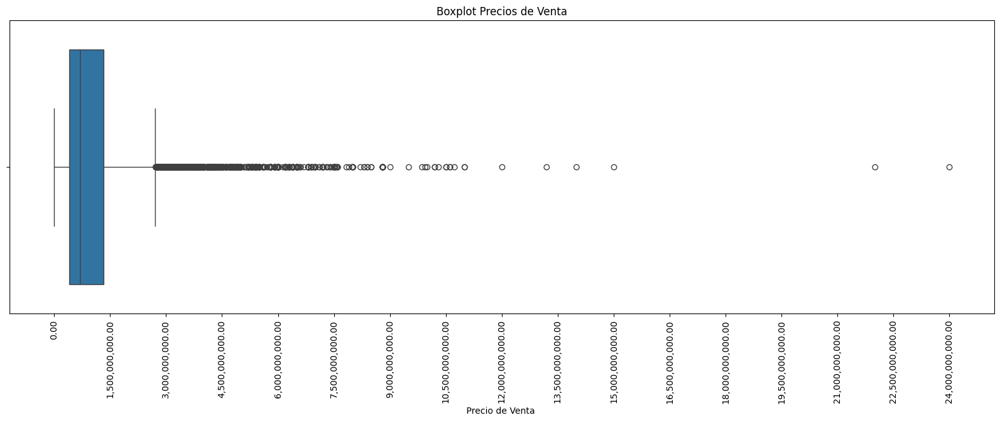

In [53]:
# Al realizar un boxplot de valores inferiores a los 150'000.000.000, se puede evidenciar lo siguiente
# Boxplot
plt.figure(figsize=(20, 6))
sns.boxplot(data=df_selected[df_selected['precio_venta']<150000000000], x='precio_venta')
plt.title('Boxplot Precios de Venta')
plt.xlabel('Precio de Venta ')
plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(integer=True, nbins=20))  # Reducir el número de ticks

plt.show()

In [54]:
# Presentación de propiedades de mayor valor
df_selected.sort_values(by='precio_venta', ascending=False).head(5)

,precio_venta,area,habitaciones,banos,sector,tipo_propiedad,tipo_operacion,parqueaderos,localidad,barrio,is_cerca_estacion_tm,is_cerca_parque
37932,4250000000000.00,300.00,3.00,4.00,CHICO,APARTAMENTO,VENTA,4.00,CHAPINERO,LOS ROSALES,0,0
21739,3300000000000.00,204.00,4.00,5.00,CHICO,APARTAMENTO,VENTA,3.00,CHAPINERO,CHICO ORIENTAL,0,0
29205,3240000000000.00,418.00,5.00,5.00,CHICO,APARTAMENTO,VENTA,4.00,CHAPINERO,S.C. QUINTA CAMACHO,1,0
20654,3000000000000.00,326.00,3.00,5.00,CHICO,APARTAMENTO,VENTA,4.00,CHAPINERO,CHICO RESERVADO,0,0
3329,2900000000000.00,277.00,3.00,4.00,SANTA BARBARA,APARTAMENTO,VENTA,3.00,USAQUEN,SANTA ANA ORIENTAL,0,0


In [55]:
conteo_precios = df_selected['precio_venta'].value_counts()
conteo_precios_ordenado = conteo_precios.sort_index(ascending=False)
nuevo_df = conteo_precios_ordenado.reset_index()
nuevo_df.columns = ['precio_venta', 'conteo']
# Se evidencian propiedades de valores similires, las cuales están por debajo del valor máximo evidenciado
nuevo_df[nuevo_df['conteo']>1].head()

,precio_venta,conteo
30,11000000000.00,2
32,10600000000.00,2
33,10500000000.00,2
35,10200000000.00,2
42,8804000000.00,15


In [56]:
# Se realiza un visualización de valores inferiores a los 3000000000
nuevo_df[nuevo_df['precio_venta']<3000000000].head()

,precio_venta,conteo
320,2999900000.00,1
321,2995000000.00,5
322,2990000000.00,21
323,2985000000.00,1
324,2980000000.00,9


In [57]:
# Se realiza ajuste de valores
df_selected = df_selected1[(df_selected1['precio_venta']<1850000000) & (df_selected1['tipo_operacion']!='ARRIENDO')]
df_selected.sort_values(by='precio_venta', ascending=False).head(5)

,precio_venta,area,habitaciones,banos,sector,tipo_propiedad,tipo_operacion,parqueaderos,localidad,barrio,is_cerca_estacion_tm,is_cerca_parque
22863,1845000000.00,214.50,3.00,4.00,SANTA BARBARA,APARTAMENTO,VENTA,3.00,USAQUEN,SANTA BIBIANA,1,0
27517,1843000000.00,183.12,3.00,3.00,CHICO,APARTAMENTO,VENTA,3.00,CHAPINERO,S.C. EL CHICO,0,1
30700,1840000000.00,165.00,2.00,3.00,CHICO,APARTAMENTO,VENTA,2.00,CHAPINERO,LOS ROSALES,0,0
6064,1840000000.00,220.00,3.00,4.00,CHICO,APARTAMENTO,VENTA,2.00,CHAPINERO,EMAUS,0,1
22809,1835000000.00,204.16,4.00,4.00,CHAPINERO ALTO,APARTAMENTO,VENTA,4.00,CHAPINERO,S.C. LAS ACACIAS,0,1


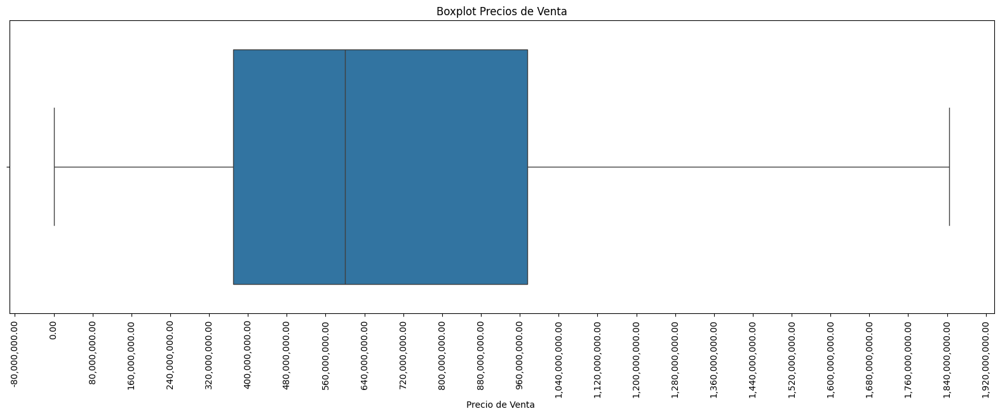

In [58]:
# Al realizar un boxplot de valores inferiores a los 1'900.000.000, se puede evidenciar lo siguiente
# Boxplot
plt.figure(figsize=(20, 6))
sns.boxplot(data=df_selected, x='precio_venta')
plt.title('Boxplot Precios de Venta')
plt.xlabel('Precio de Venta ')
plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(integer=True, nbins=33))  # Reducir el número de ticks

plt.show()

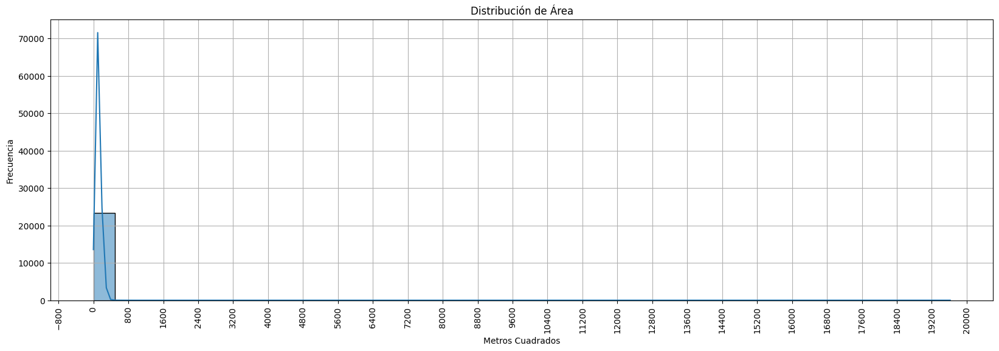

In [59]:
# Gráfico de distribución para la disponibilidad
plt.figure(figsize=(20, 6))
sns.histplot(df_selected['area'], bins=40, kde=True)
plt.title('Distribución de Área')
plt.xlabel('Metros Cuadrados')
plt.ylabel('Frecuencia')
plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(integer=True, nbins=33))  # Reducir el número de ticks
plt.grid()
plt.show()

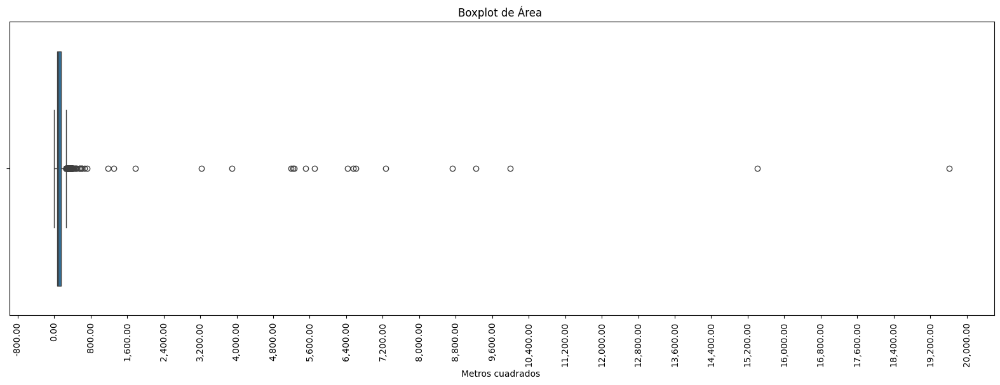

In [60]:
# Boxplot
plt.figure(figsize=(20, 6))
sns.boxplot(data=df_selected, x='area')
plt.title('Boxplot de Área ')
plt.xlabel('Metros cuadrados ')
plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.gca().xaxis.set_major_locator(plt.MaxNLocator(integer=True, nbins=33))  # Reducir el número de ticks

plt.show()

Con lo anterior, se evidencia que la gran mayoría de información corresponde a áreas inferiores a 800mt<sup>2</sup>

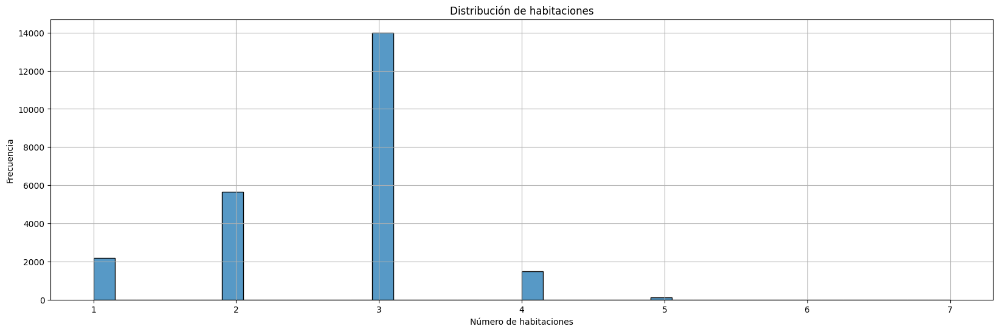

In [62]:
# Gráfico de distribución 
plt.figure(figsize=(20, 6))
sns.histplot(df_selected['habitaciones'], bins=40)
plt.title('Distribución de habitaciones')
plt.xlabel('Número de habitaciones')
plt.ylabel('Frecuencia')
plt.grid()
plt.show()

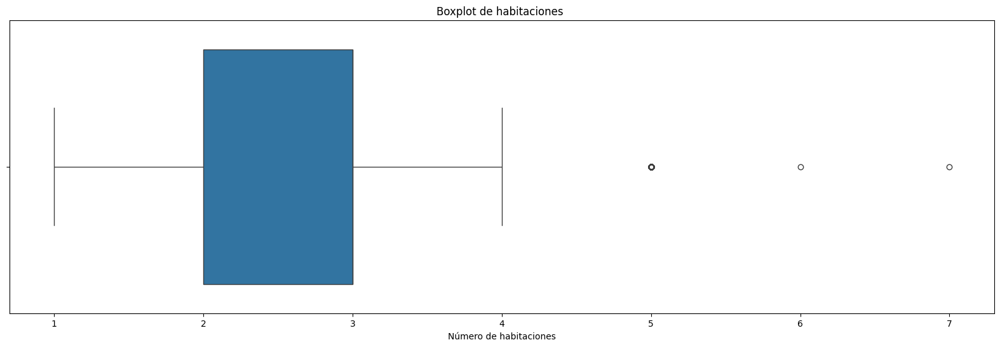

In [63]:
# Boxplot
plt.figure(figsize=(20, 6))
sns.boxplot(data=df_selected, x='habitaciones')
plt.title('Boxplot de habitaciones ')
plt.xlabel('Número de habitaciones')
plt.show()

De los gráficos anteriores, se puede aprecuar que la gran mayoría tiene entre 2 y 3 habitaciones, lo que puede insidir en la tendencia de venta. Así mismo, se evidencian registros con más de 4 habitaciones lo que puede sugerir un precios más elevado respecto a los de menos habitaciones.

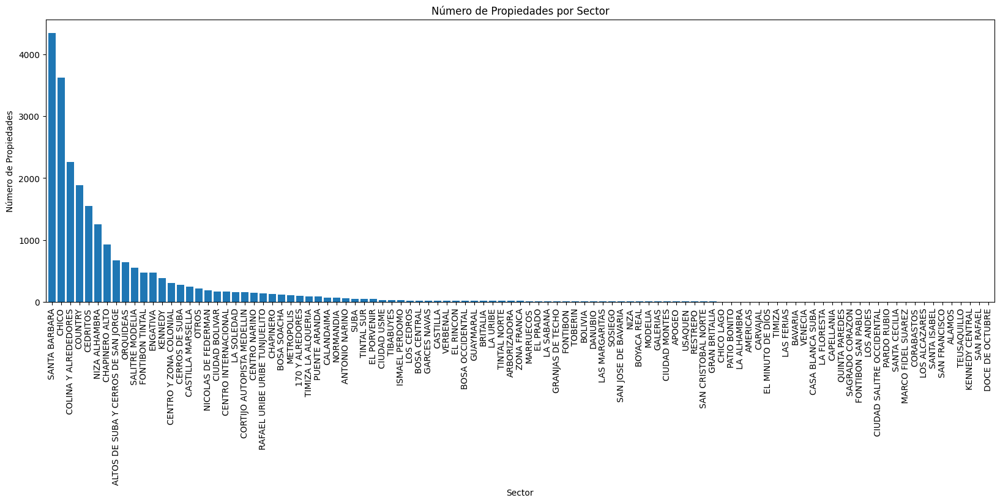

In [65]:
# Histograma 
plt.figure(figsize=(20, 6))
df_selected['sector'].value_counts().plot(kind='bar', width=0.8)
plt.title('Número de Propiedades por Sector')
plt.xlabel('Sector')
plt.ylabel('Número de Propiedades')
plt.show()

El anterior, evidencia la cantidad de propiedades disponibles por barrio, lo cual puede ayudar en temas de ubicación geografica y los precios acorde al sector. El sector con mayor número de propiedades se encuentra en CHICO, seguido de SANTA BARBARA.

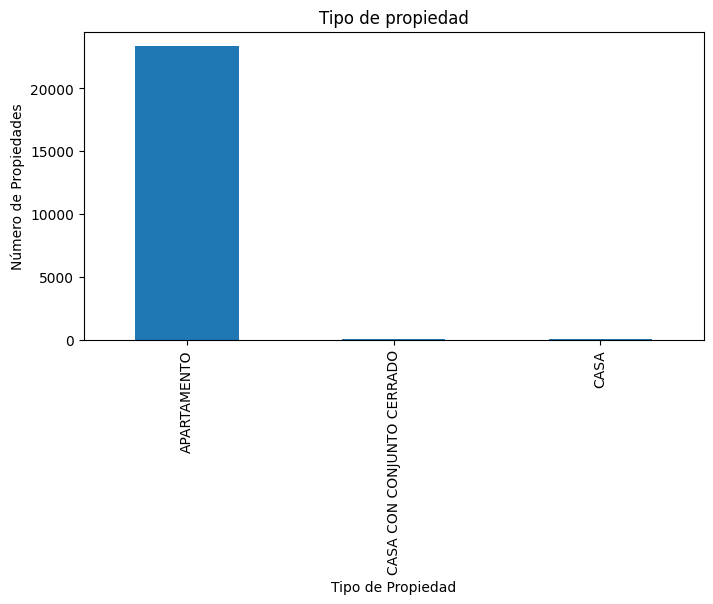

In [67]:
# Gráfico de barras
plt.figure(figsize=(8, 4))
df_selected['tipo_propiedad'].value_counts().plot(kind='bar')
plt.title('Tipo de propiedad')
plt.xlabel('Tipo de Propiedad')
plt.ylabel('Número de Propiedades')
plt.show()

La anterior visualización, denota el tipo de propiedad de mayor demanda son las de tipo 'APARTAMENTO', lo cual inside en los precios de venta y/o preferencias por parte de los compradores.

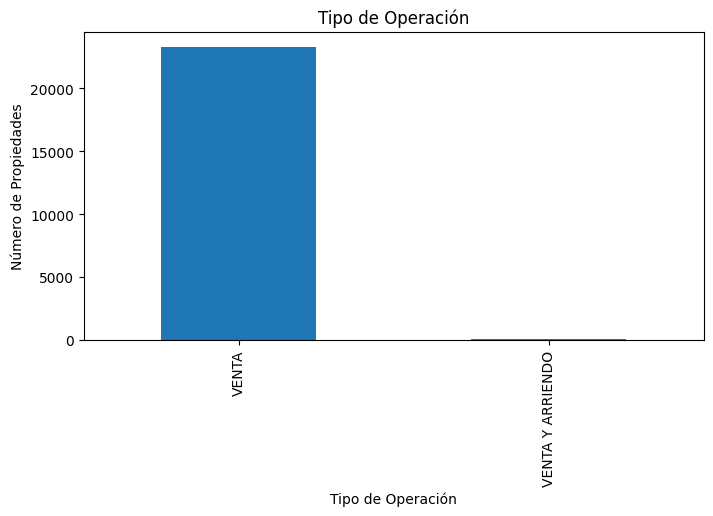

In [69]:
# Gráfico de barras para room_type
plt.figure(figsize=(8, 4))
df_selected['tipo_operacion'].value_counts().plot(kind='bar')
plt.title('Tipo de Operación')
plt.xlabel('Tipo de Operación')
plt.ylabel('Número de Propiedades')
plt.show()

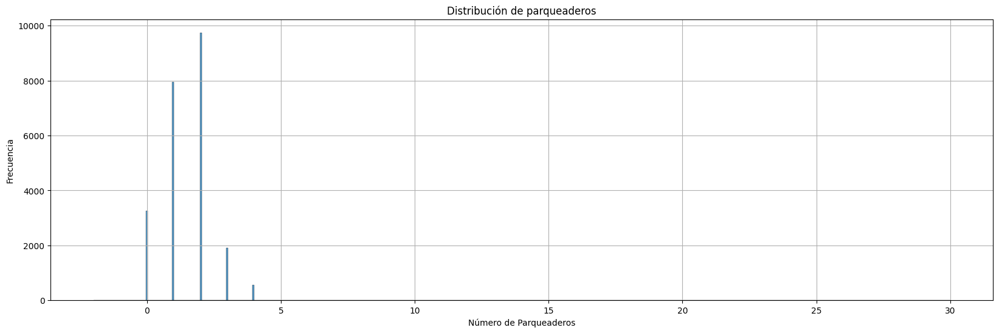

In [70]:
# Gráfico de distribución 
plt.figure(figsize=(20, 6))
sns.histplot(df_selected['parqueaderos'])
plt.title('Distribución de parqueaderos')
plt.xlabel('Número de Parqueaderos')
plt.ylabel('Frecuencia')
plt.grid()
plt.show()

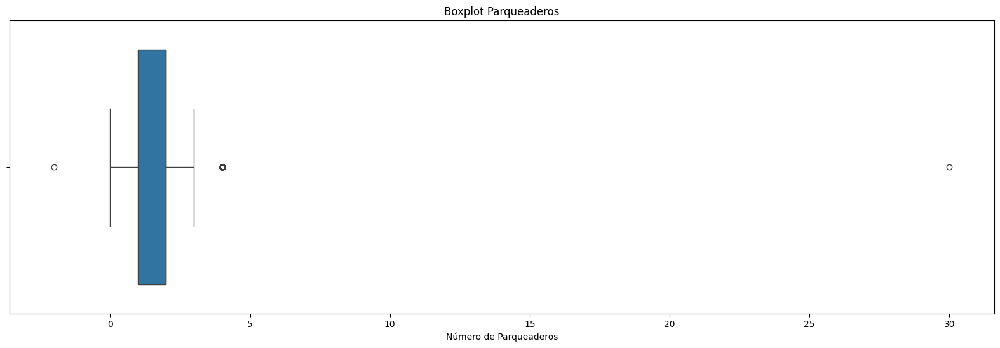

In [71]:
# Boxplot
plt.figure(figsize=(20, 6))
sns.boxplot(data=df_selected, x='parqueaderos')
plt.title('Boxplot Parqueaderos')
plt.xlabel('Número de Parqueaderos')
plt.show()

Con lo anterior, se evidencian datos atípicos, los cuales pueden influir en el modelo, por lo cual se procede a consultar las caracteristicas de dichos valores, encontrando que los valores corresponden a errores de digitación dado que en la descripción de los mismos nombran la cantidad de parqueaderos disponibles


In [73]:
# datos en dataset original
aptos_df[aptos_df['tipo_operacion'].isin(['VENTA','VENTA Y ARRIENDO']) & ((aptos_df['parqueaderos']<0) | (aptos_df['parqueaderos']>10))]

,_id,codigo,tipo_propiedad,tipo_operacion,precio_venta,area,habitaciones,banos,administracion,parqueaderos,sector,estrato,antiguedad,latitud,longitud,direccion,descripcion,website,last_view,datetime,url,timeline,estado,compañia,precio_arriendo,jacuzzi,piso,closets,chimenea,permite_mascotas,gimnasio,ascensor,conjunto_cerrado,piscina,salon_comunal,terraza,vigilancia,coords_modified,localidad,barrio,estacion_tm_cercana,distancia_estacion_tm_m,is_cerca_estacion_tm,parque_cercano,distancia_parque_m,is_cerca_parque
296,66d86c7fceda690e85508888,4387932,APARTAMENTO,VENTA,307169231.00,67.00,3.00,2.00,278000.00,-2.00,RESTREPO,3.00,ENTRE 0 Y 5 ANOS,4.59,-74.11,CALLE 29 A SUR # 29 - 03,"apartamento en venta de 67m2, con vista exterior, ubicado en un 10mo piso (torre 1 apto 1004), acceso por escaleras y ascens...",habi.co,2024-08-18 14:49:20.583,2024-07-03 23:28:38.829,https://habi.co/page-data/venta-apartamentos/19883615372/altos-29---apartamento-venta-santander-sur-antonio-narino/page-data...,[],NaN,NaN,NaN,0.00,NaN,NaN,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,False,ANTONIO NARINO,SANTANDER_,NQS - Calle 30 S,685.12,0,PARQUE ZONAL VILLA MAYOR CEMENTERIO,728.06,0
38582,66d86e5aceda690e85511e16,3438-M5140399,APARTAMENTO,VENTA,1080000000.00,177.00,4.00,4.00,690000.00,30.00,SANTA BARBARA,5.00,ENTRE 0 Y 5 ANOS,4.70,-74.04,NaN,"se vende hermosos aparamento excelente iluminacion ,ubicado en el barrio santa barbara edificio la toscana, 3 alcobas , 4 b...",metrocuadrado.com,2024-08-13 14:32:56.255,2024-08-13 14:32:56.255,NaN,NaN,USADO,GESTION CORPORATIVA Y COMERCIAL,NaN,0.00,NaN,NaN,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,False,USAQUEN,SANTA BARBARA CENTRAL IV SECTOR,Calle 127,2182.40,0,PARQUE METROPOLITANO EL COUNTRY,659.16,0


In [74]:
# Datos en variables escogidas
df_selected[((df_selected['parqueaderos']<0) | (df_selected['parqueaderos']>10))]

,precio_venta,area,habitaciones,banos,sector,tipo_propiedad,tipo_operacion,parqueaderos,localidad,barrio,is_cerca_estacion_tm,is_cerca_parque
296,307169231.00,67.00,3.00,2.00,RESTREPO,APARTAMENTO,VENTA,-2.00,ANTONIO NARINO,SANTANDER_,0,0
38582,1080000000.00,177.00,4.00,4.00,SANTA BARBARA,APARTAMENTO,VENTA,30.00,USAQUEN,SANTA BARBARA CENTRAL IV SECTOR,0,0


Para los anteriores valores, se procede a realizar la corrección respectiva corrección de valores y su posterior visualización en un boxplot

In [76]:
df_selected['parqueaderos'] = df_selected['parqueaderos'].replace({-2: 2, 30: 3})

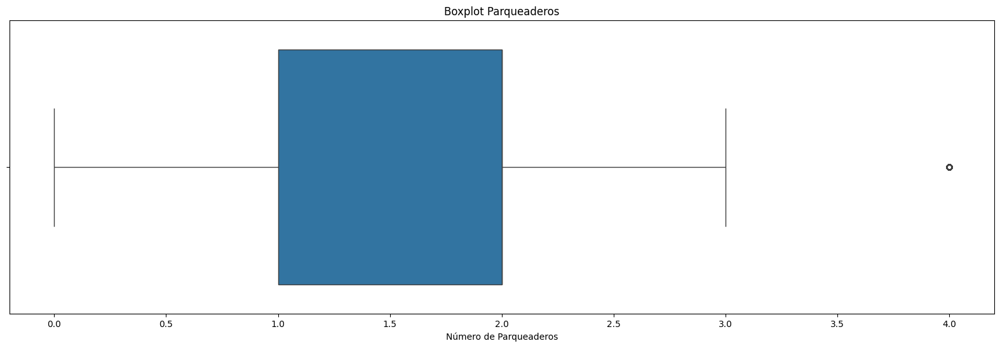

In [77]:
# Boxplot
plt.figure(figsize=(20, 6))
sns.boxplot(data=df_selected, x='parqueaderos')
plt.title('Boxplot Parqueaderos')
plt.xlabel('Número de Parqueaderos')
plt.show()

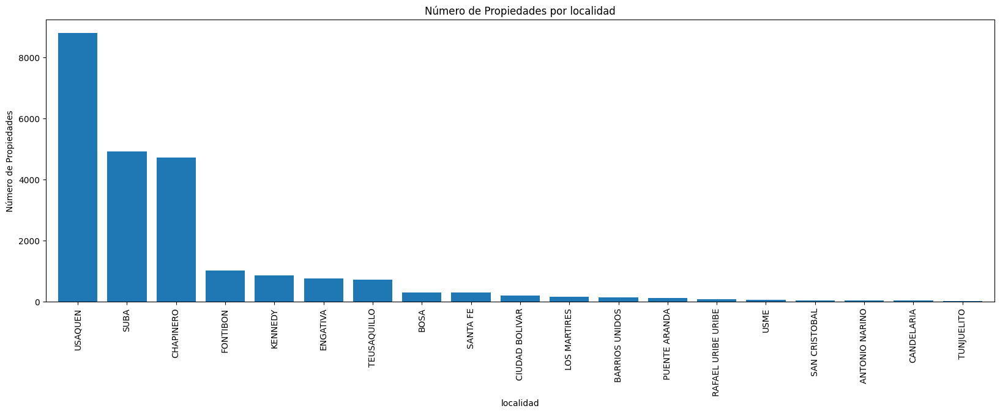

In [78]:
# Histograma 
plt.figure(figsize=(20, 6))
df_selected['localidad'].value_counts().plot(kind='bar', width=0.8)
plt.title('Número de Propiedades por localidad')
plt.xlabel('localidad')
plt.ylabel('Número de Propiedades')
plt.show()

Se evidencia que la localidad con mayor número de propiedades en venta es USAQUEN

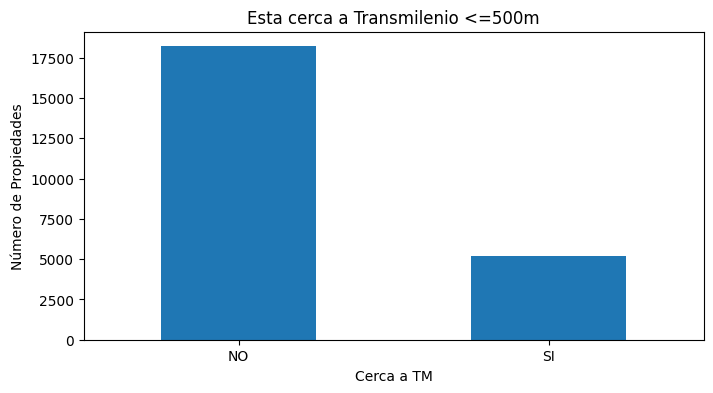

In [80]:
# Gráfico de barras para room_type
plt.figure(figsize=(8, 4))
df_selected['is_cerca_estacion_tm'].value_counts().plot(kind='bar')
plt.title('Esta cerca a Transmilenio <=500m')
plt.xlabel('Cerca a TM')
plt.ylabel('Número de Propiedades')
plt.xticks(ticks=[0, 1], labels=['NO', 'SI'], rotation=0)
plt.show()

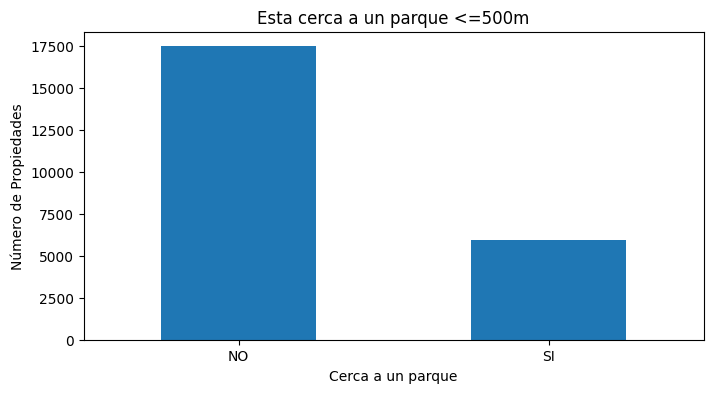

In [81]:
# Gráfico de barras para room_type
plt.figure(figsize=(8, 4))
df_selected['is_cerca_parque'].value_counts().plot(kind='bar')
plt.title('Esta cerca a un parque <=500m')
plt.xlabel('Cerca a un parque')
plt.ylabel('Número de Propiedades')
plt.xticks(ticks=[0, 1], labels=['NO', 'SI'], rotation=0)
plt.show()

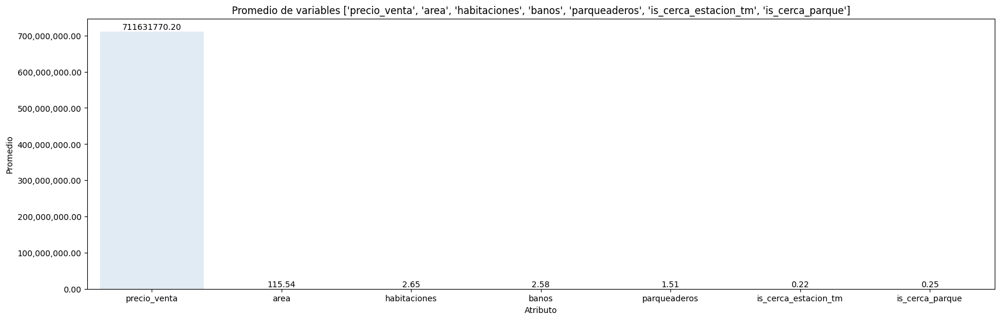

In [82]:
# Se realiza un promedio de datos númericos 
omitir_obj = ['sector',
              'tipo_propiedad',
              'tipo_operacion',
              'localidad',
              'barrio']

promedios = [df_selected[atributo].mean() for atributo in df_selected.loc[:, ~df_selected.columns.isin(omitir_obj)]]

cols = ['precio_venta','area', 'habitaciones', 'banos','parqueaderos','is_cerca_estacion_tm','is_cerca_parque']

plt.figure(figsize=(20, 6))
sns.barplot(x=cols, y=promedios, palette='Blues')
plt.title(f'Promedio de variables {cols}')
plt.xlabel('Atributo')
plt.ylabel('Promedio')

# Agregar los valores a cada barra
for i, v in enumerate(promedios):
    plt.text(i, v + 0.5, f'{v:.2f}', ha='center', va='bottom')

plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.show()

Lo anterior evidencia:
- Un promedio del precio de venta oscila entre los `$700.000.000` 
- El área promedio aproximado es de 115 mt<sup>2</sup>
- La cantidad de habitaciones promedio es entre 2 y 3
- La cantidad de baños promedio oscila entre 2 y 3

## Analisis Bivariado
([Volver al inicio](#Indice))

Con los atributos seleccionados, se pretende identificar los precios de venta y su influencia entre cada variable


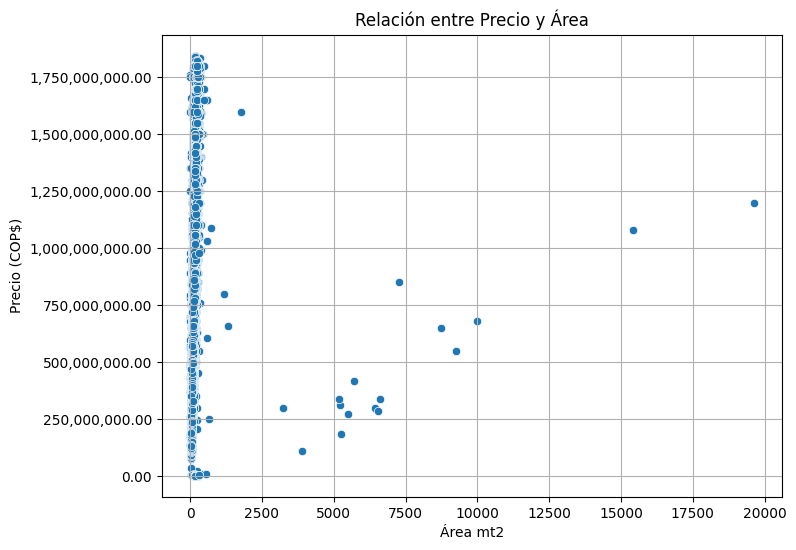

In [86]:
# Análisis de correlación entre price y availability_365
plt.figure(figsize=(8, 6))
sns.scatterplot(x='area', y='precio_venta', data=df_selected)
plt.title('Relación entre Precio y Área')
plt.ylabel('Precio (COP$)')
plt.xlabel('Área mt2')
#plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.grid()
plt.show()

In [87]:
correlation = df_selected['precio_venta'].corr(df_selected['area'])
print(f'Coeficiente de correlación: {correlation}')

Coeficiente de correlación: 0.21184696074540615


El resultado anterior, no denota una tendencia marcada/lineal entre el precio y la disponibilidad; lo que quiere decir que no hay una correlación marcada entre los atributos.

In [89]:
# Se realiza una comparación 
fig = px.scatter(df_selected, 
                 x='precio_venta', 
                 y='sector',
                 width=1024, 
                 height=800,
                 color='sector') 
fig.update_layout(xaxis_title="Precio Venta",yaxis_title="Sector", showlegend=False)
fig.update_xaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras

fig.show()

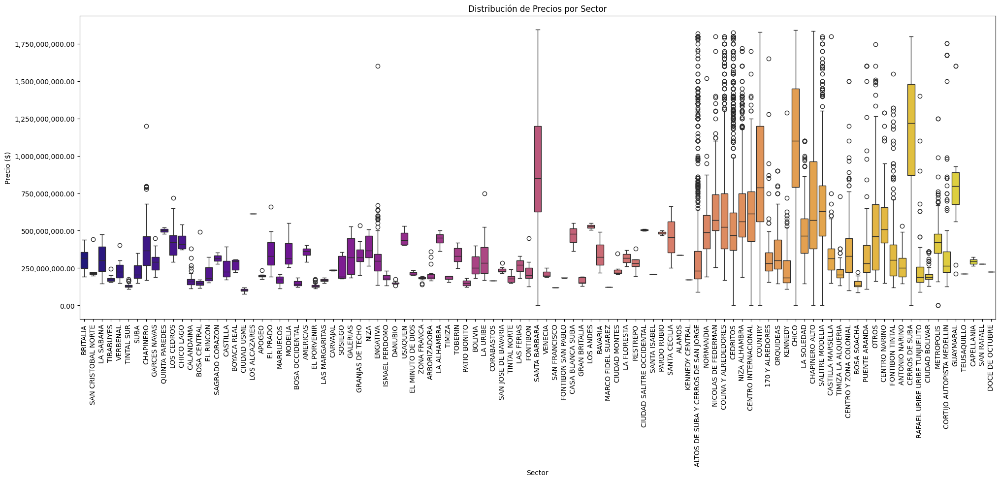

In [90]:
# Comparar distribución 
# Se hace uso de un boxplot
plt.figure(figsize=(24, 8))
sns.boxplot(x='sector', y='precio_venta', data=df_selected, palette='plasma')
plt.title('Distribución de Precios por Sector')
plt.xlabel('Sector')
plt.ylabel('Precio ($)')
plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.xticks(rotation=90)
plt.show()

Para complementar el gráfico anterior se realiza un análisis de pareto

In [92]:
# Normalización del atributo sector a traves de conteos
sector_frec_cumsum = df_selected["sector"].value_counts(normalize=True).cumsum()
sector_frec_cumsum

sector
SANTA BARBARA          0.19
CHICO                  0.35
COLINA Y ALREDEDORES   0.45
COUNTRY                0.53
CEDRITOS               0.60
                       ... 
ALAMOS                 1.00
TEUSAQUILLO            1.00
KENNEDY CENTRAL        1.00
SAN RAFAEL             1.00
DOCE DE OCTUBRE        1.00
Name: proportion, Length: 103, dtype: float64

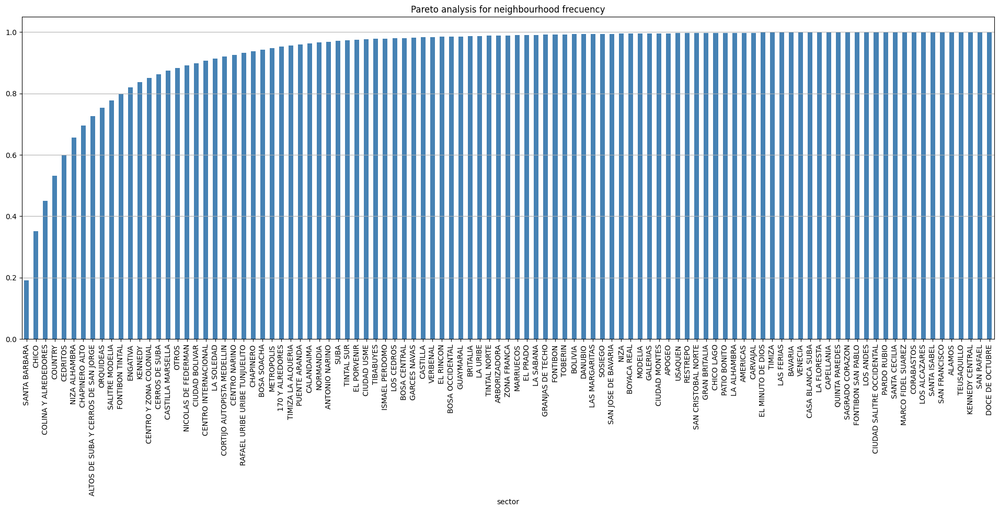

In [93]:
# Plotting pareto analysis for Sector frecuency
plt.figure(figsize=(24, 8))
sector_frec_cumsum.plot(kind="bar", color="steelblue")
plt.title("Pareto analysis for neighbourhood frecuency")
plt.grid(axis="y")
plt.show()

In [94]:
# Se realiza una lista de los sectores que más representan los datos y/o concentran el 80%
most_representative_sector = sector_frec_cumsum.loc[sector_frec_cumsum < 0.8].index.tolist()
most_representative_sector

['SANTA BARBARA',
 'CHICO',
 'COLINA Y ALREDEDORES',
 'COUNTRY',
 'CEDRITOS',
 'NIZA ALHAMBRA',
 'CHAPINERO ALTO',
 'ALTOS DE SUBA Y CERROS DE SAN JORGE',
 'ORQUIDEAS',
 'SALITRE MODELIA',
 'FONTIBON TINTAL']

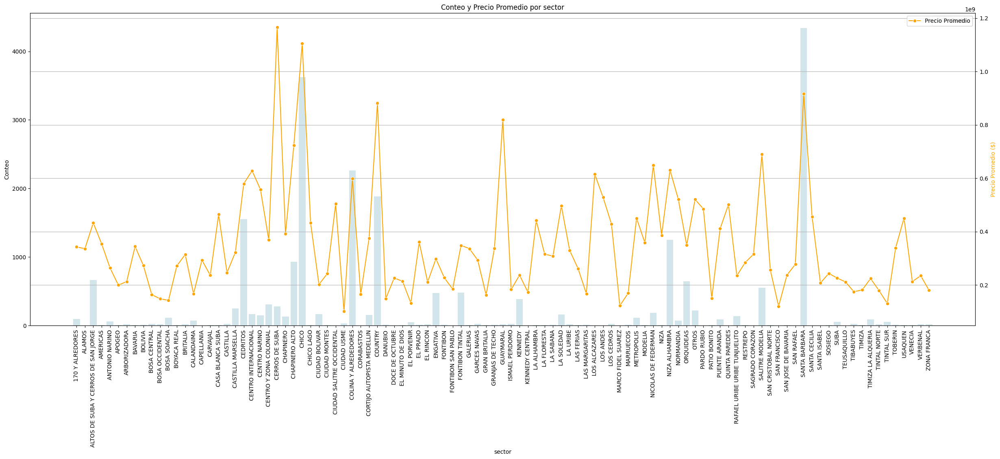

In [95]:
# Calcular el conteo y el precio promedio por sector
sector_analysis = df_selected.groupby('sector').agg(
    count=('sector', 'count'),
    avg_price=('precio_venta', 'mean')
).reset_index()

# Crear el gráfico de barras
plt.figure(figsize=(30, 10))
bar_ax = sns.barplot(x='sector', y='count', data=sector_analysis, color='lightblue', label='Conteo', alpha=0.6)

# Crear un segundo eje para el precio promedio
ax2 = bar_ax.twinx()  # Usar el eje de barras
sns.lineplot(x='sector', y='avg_price', data=sector_analysis, color='orange', marker='o', label='Precio Promedio', ax=ax2)

# Configuración del gráfico
plt.title('Conteo y Precio Promedio por sector')
bar_ax.set_xlabel('sector')
bar_ax.set_ylabel('Conteo')
ax2.set_ylabel('Precio Promedio ($)', color='orange')

# Rotar los nombres del eje X usando set_xticklabels
bar_ax.set_xticklabels(sector_analysis['sector'], rotation=90)
#bar_ax.set_xticklabels(neighbourhood_analysis['sector'], rotation=90, ha='right', fontsize=14)

# Agregar leyendas
plt.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.grid()
#plt.tight_layout() 
plt.show()


Con el gráfico anterior, se evidencia y comprueba que los barrios de mayor precios son CHICO, SANTA BARBARA, COLINA Y ALREDEDORES

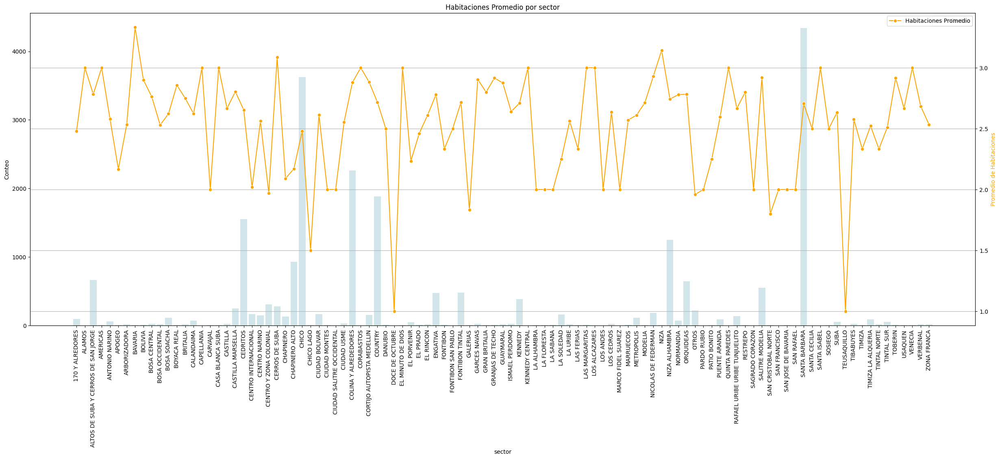

In [97]:
# Calcular el conteo y el precio promedio por habitaciones
sector_analysis = df_selected.groupby('sector').agg(
    count=('sector', 'count'),
    avg_price=('habitaciones', 'mean')
).reset_index()

# Crear el gráfico de barras
plt.figure(figsize=(30, 10))
bar_ax = sns.barplot(x='sector', y='count', data=sector_analysis, color='lightblue', label='Conteo', alpha=0.6)

# Crear un segundo eje para el precio promedio
ax2 = bar_ax.twinx()  # Usar el eje de barras
sns.lineplot(x='sector', y='avg_price', data=sector_analysis, color='orange', marker='o', label='Habitaciones Promedio', ax=ax2)

# Configuración del gráfico
plt.title('Habitaciones Promedio por sector')
bar_ax.set_xlabel('sector')
bar_ax.set_ylabel('Conteo')
ax2.set_ylabel('Promedio de Habitaciones', color='orange')

# Rotar los nombres del eje X usando set_xticklabels
bar_ax.set_xticklabels(sector_analysis['sector'], rotation=90)

# Agregar leyendas
plt.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.grid()
#plt.tight_layout() 
plt.show()


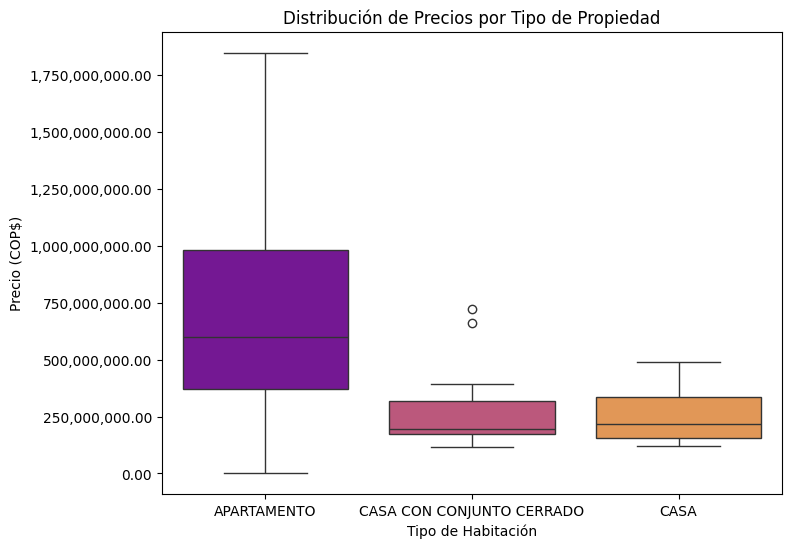

In [98]:
# Comparar price por tipo_propiedad
plt.figure(figsize=(8, 6))
sns.boxplot(x='tipo_propiedad', y='precio_venta', data=df_selected, palette='plasma')
plt.title('Distribución de Precios por Tipo de Propiedad')
plt.xlabel('Tipo de Habitación')
plt.ylabel('Precio (COP$)')
plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.show()

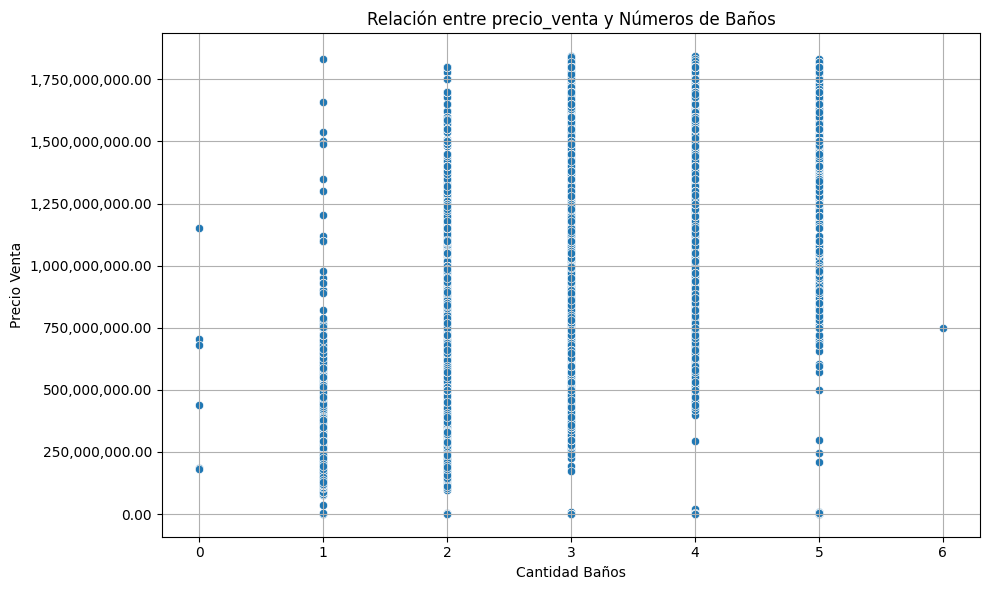

In [99]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='banos', y='precio_venta', data=df_selected)
plt.title('Relación entre precio_venta y Números de Baños')
plt.ylabel('Precio Venta')
plt.xlabel('Cantidad Baños')
#plt.xticks(rotation=90)  # Rotar las etiquetas 
#plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.grid()
plt.tight_layout() 
plt.show()

In [100]:
correlation = df_selected['precio_venta'].corr(df_selected['banos'])
print(f'Coeficiente de correlación: {correlation}')

Coeficiente de correlación: 0.743107346153154


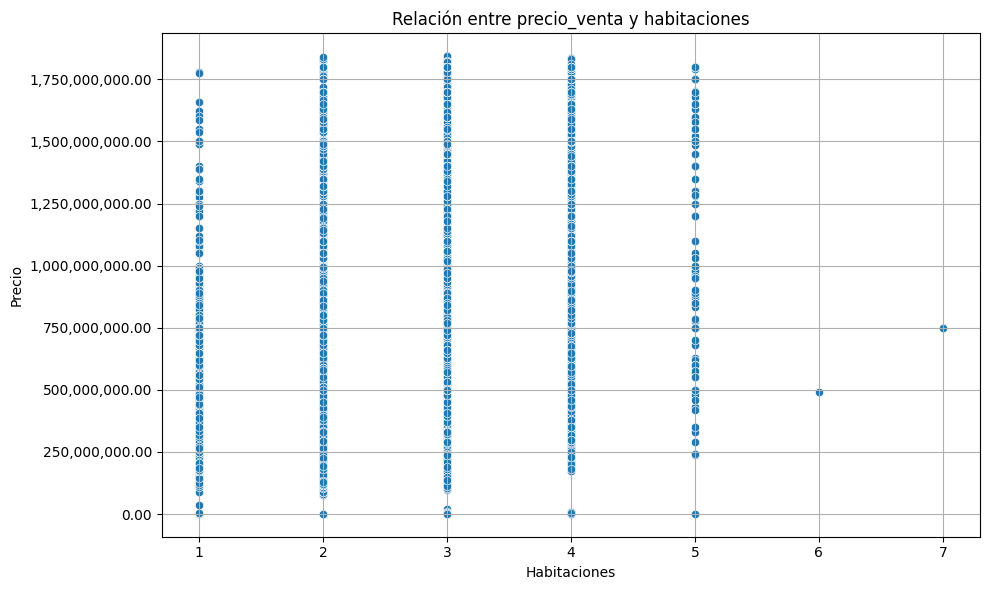

In [102]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='habitaciones', y='precio_venta', data=df_selected)
plt.title('Relación entre precio_venta y habitaciones')
plt.ylabel('Precio')
plt.xlabel('Habitaciones')
#plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.grid()
plt.tight_layout() 
plt.show()

In [103]:
correlation = df_selected['precio_venta'].corr(df_selected['habitaciones'])
print(f'Coeficiente de correlación: {correlation}')

Coeficiente de correlación: 0.3103533342340149


El número de habitaciones no tiene una relación lineal significativa con el precio de venta.

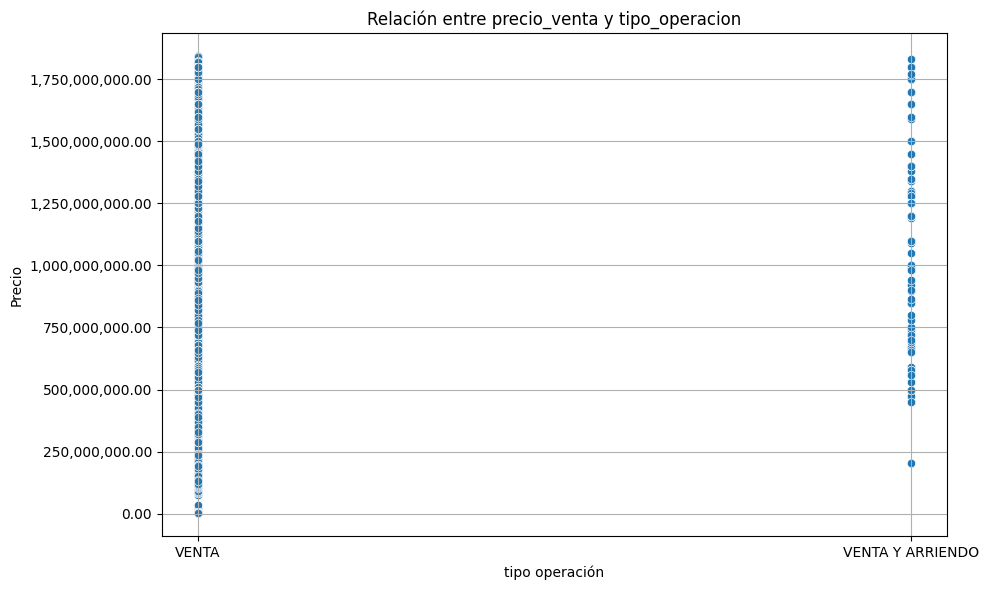

In [105]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='tipo_operacion', y='precio_venta', data=df_selected)
plt.title('Relación entre precio_venta y tipo_operacion')
plt.ylabel('Precio')
plt.xlabel('tipo operación')
#plt.xticks(rotation=90)  # Rotar las etiquetas 
plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.grid()
plt.tight_layout() 
plt.show()

Se evidencian mayores precios cuando el tipo_operacion corresponde a una VENTA mientras que la operación VENTA Y ARRIENDO se evidencian precios de venta inferiores

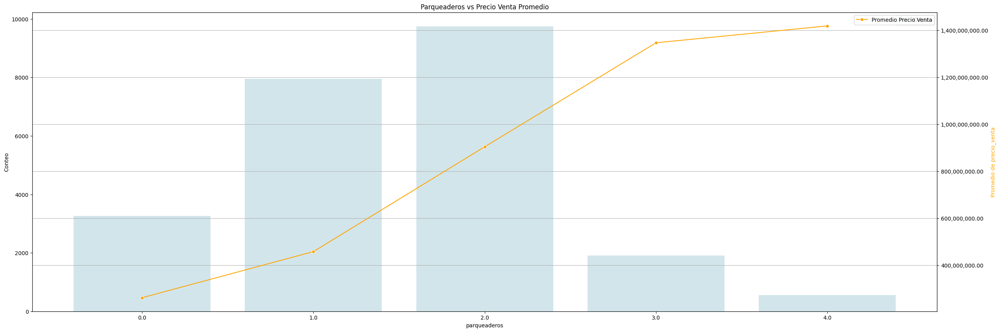

In [107]:
# Calcular el conteo y el precio promedio
parqueaderos_analysis = df_selected.groupby('parqueaderos').agg(
    count=('parqueaderos', 'count'),
    avg_price=('precio_venta', 'mean')
).reset_index()

# Crear el gráfico de barras
plt.figure(figsize=(30, 10))
bar_ax = sns.barplot(x='parqueaderos', y='count', data=parqueaderos_analysis, color='lightblue', label='Conteo', alpha=0.6)

# Crear un segundo eje para el precio promedio
ax2 = bar_ax.twinx()  # Usar el eje de barras
sns.lineplot(x='parqueaderos', y='avg_price', data=parqueaderos_analysis, color='orange', marker='o', label='Promedio Precio Venta', ax=ax2)

# Configuración del gráfico
plt.title('Parqueaderos vs Precio Venta Promedio')
bar_ax.set_xlabel('parqueaderos')
bar_ax.set_ylabel('Conteo')
ax2.set_ylabel('Promedio de precio_venta', color='orange')

plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
# Rotar los nombres del eje X usando set_xticklabels
bar_ax.set_xticklabels(parqueaderos_analysis['parqueaderos'], rotation=0)

# Agregar leyendas
plt.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.grid()
#plt.tight_layout() 
plt.show()


Con lo anterior, se puede evidenciar que cuanto más parqueaderos tenga la propiedad, el promedio de precio de venta se incrementa

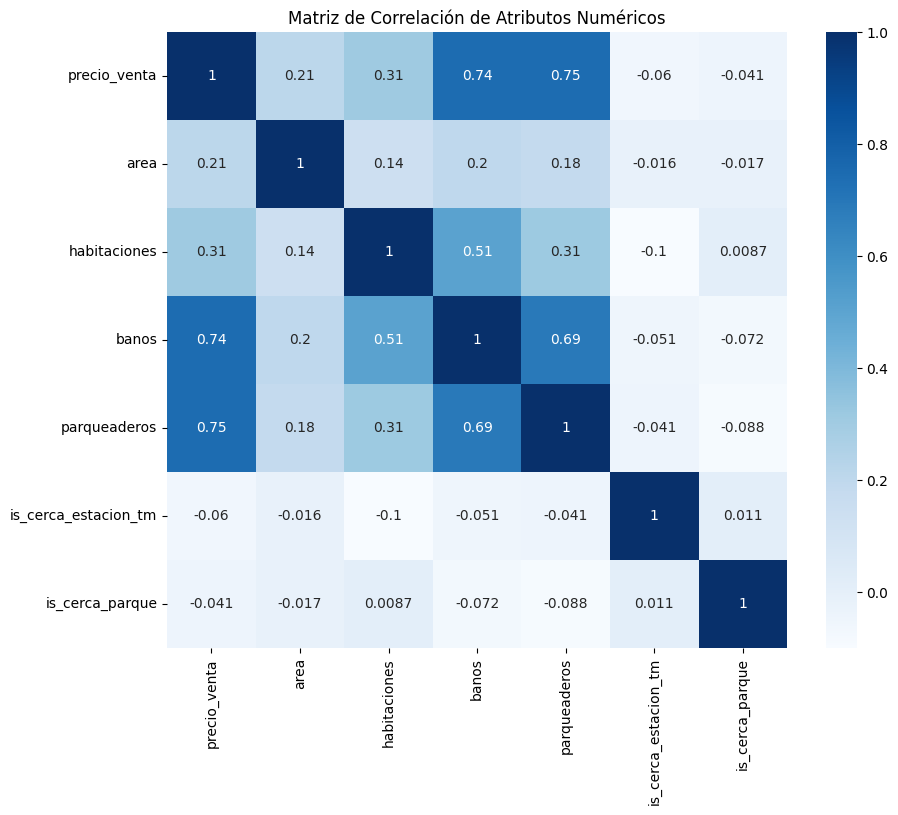

In [109]:
# Correlación de atributos numéricos
plt.figure(figsize=(10, 8))
sns.heatmap(df_selected.loc[:, ~df_selected.columns.isin(omitir_obj)].corr(), annot=True, cmap='Blues')
plt.title('Matriz de Correlación de Atributos Numéricos')
plt.show()

## Analisis Multivariado
([Volver al inicio](#Indice))

In [111]:
# Se realiza una comparación entre precio_venta, sector y tipo_propiedad
fig = px.scatter(df_selected, 
                 x='precio_venta', 
                 y='sector',
                 width=1024, 
                 height=900,
                 labels={
                     "tipo_propiedad": "Tipo Propiedad"
                 },
                 color='tipo_propiedad') 
fig.update_layout(xaxis_title="Precio",yaxis_title="sector")
fig.update_xaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras
fig.update_yaxes(tickformat=",.2f")  # Formatear el eje Y a decimal de 2 cifras
fig.show()

Se evidencian varias propiedades de alto valor en sector CHICO

In [113]:
# Se realiza una comparación entre area, precio_venta y tipo_propiedad
fig = px.scatter(df_selected, 
                 x='area',
                 y='precio_venta', 
                 width=1024, 
                 height=900,
                 labels={
                     "tipo_propiedad": "Tipo Propiedad"
                 },
                 color='tipo_propiedad') 
fig.update_layout(xaxis_title="Área mt2",yaxis_title="Precio")
fig.update_xaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras
fig.update_yaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras

fig.show()

Propiedades de mayor valor y área son de tipo APARTAMENTO

In [115]:
# Se realiza una comparación entre habitaciones, precio_venta y banos
fig = px.scatter(df_selected, 
                 x='habitaciones',
                 y='precio_venta', 
                 width=1024, 
                 height=900,
                 labels={
                     "banos": "Cantidad de baños"
                 },
                 color='banos') 
fig.update_layout(xaxis_title="Habitaciones",yaxis_title="Precio")
fig.update_xaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras
fig.update_yaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras

fig.show()

In [116]:
# Se realiza una comparación entre sector, precio_venta y is_cerca_estacion_tm
df_selected['cerca_tm_label'] = df_selected['is_cerca_estacion_tm'].map({0: 'NO', 1: 'SI'})

fig = px.scatter(df_selected, 
                 x='sector',
                 y='precio_venta', 
                 width=1024, 
                 height=900,
                 labels={
                     "cerca_tm_label": "Cerca a una estación de TM"
                 },
                 color='cerca_tm_label',
                 color_discrete_map={'NO': 'red', 'SI': 'green'}) 
fig.update_layout(title="Comparación entre Sector y Precio de Venta",
                  xaxis_title="sector",
                  yaxis_title="Precio")
fig.update_xaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras
fig.update_yaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras

fig.show()

Lo anterior evidencia en algunas ocasiones, que cuanto más cerca se está a una estación de transmilenio inferior es el precio de precio de venta.

In [118]:
# Se realiza una comparación entre sector, precio_venta y is_cerca_estacion_tm
df_selected['cerca_parque_label'] = df_selected['is_cerca_parque'].map({0: 'NO', 1: 'SI'})

fig = px.scatter(df_selected, 
                 x='precio_venta',
                 y='sector', 
                 width=1024, 
                 height=900,
                 labels={
                     "cerca_parque_label": "Cerca a un parque"
                 },
                 color='cerca_parque_label',
                 color_discrete_map={'NO': 'red', 'SI': 'green'}) 
fig.update_layout(title="Comparación entre Sector y Precio de Venta",
                  xaxis_title="sector",
                  yaxis_title="Precio")
fig.update_xaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras
fig.update_yaxes(tickformat=",.2f")  # Formatear el eje X a decimal de 2 cifras

fig.show()

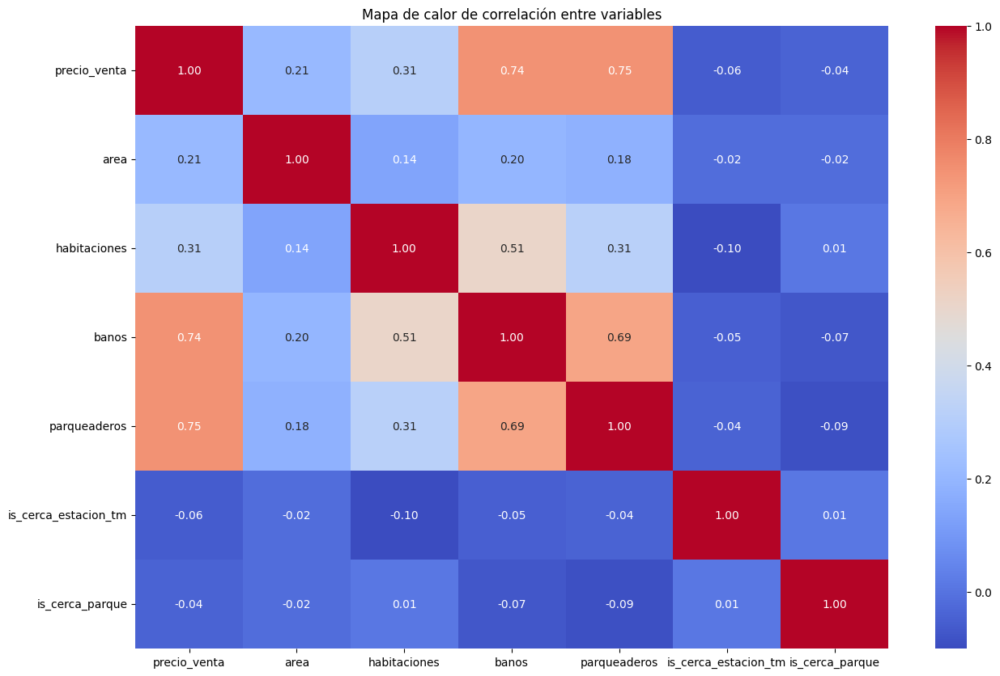

In [119]:
# Visualización de correlación
plt.figure(figsize=(15, 10))
sns.heatmap(df_selected.select_dtypes(include=['float64', 'int64']).corr(), annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Mapa de calor de correlación entre variables')
plt.show()

## Modelo
([Volver al inicio](#Indice))

In [121]:
df = aptos_df.select_dtypes(include=['float64', 'int64'])
df.columns

Index(['precio_venta', 'area', 'habitaciones', 'banos', 'administracion',
       'parqueaderos', 'estrato', 'latitud', 'longitud', 'precio_arriendo',
       'jacuzzi', 'piso', 'closets', 'chimenea', 'permite_mascotas',
       'gimnasio', 'ascensor', 'conjunto_cerrado', 'piscina', 'salon_comunal',
       'terraza', 'vigilancia', 'distancia_estacion_tm_m',
       'is_cerca_estacion_tm', 'distancia_parque_m', 'is_cerca_parque'],
      dtype='object')

In [122]:
df = df_selected.select_dtypes(include=['float64', 'int64'])
df.columns

Index(['precio_venta', 'area', 'habitaciones', 'banos', 'parqueaderos',
       'is_cerca_estacion_tm', 'is_cerca_parque'],
      dtype='object')

In [123]:
features = ['area', 'habitaciones', 'banos', 'parqueaderos','is_cerca_estacion_tm', 'is_cerca_parque']

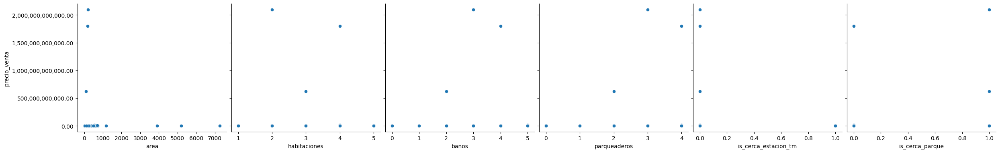

In [124]:
sns.pairplot(aptos_df.sample(frac=0.2), height=4, y_vars="precio_venta", x_vars=features, kind="scatter")
#plt.xticks(rotation=45)
#plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.show()

In [125]:
df_selected["precio_venta"].describe(percentiles=[.25, .5, .75, .95, .99])

count        23421.00
mean     711631770.20
std      435161221.95
min        1000000.00
25%      369000000.00
50%      600000000.00
75%      975000000.00
95%     1600000000.00
99%     1800000000.00
max     1845000000.00
Name: precio_venta, dtype: float64

In [126]:
# Revisón de campos vacíos/nulos y tipo de dato
nulos_y_tipos = pd.DataFrame({
    'nulos': df_selected.isnull().sum(),
    'tipo_dato': df_selected.dtypes
})
nulos_y_tipos

,nulos,tipo_dato
precio_venta,0,float64
area,0,float64
habitaciones,0,float64
banos,0,float64
sector,670,object
tipo_propiedad,0,object
tipo_operacion,0,object
parqueaderos,0,float64
localidad,0,object
barrio,135,object


### Features del modelo

In [128]:
X = df_selected[features]
Y = df_selected['precio_venta']

### Particionamiento de conjunto de datos (Prueba - Validación)

In [130]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

In [131]:
X_train.shape, y_train.shape

((18736, 6), (18736,))

In [132]:
X_test.shape, y_test.shape

((4685, 6), (4685,))

### Entrenamiento

In [134]:
regression = LinearRegression()

In [135]:
regression.fit(X_train, y_train)

LinearRegression()

### Intercepto

In [137]:
pd.DataFrame({"columns": features, "coef": regression.coef_})

,columns,coef
0,area,92788.17
1,habitaciones,-41398038.78
2,banos,196966137.96
3,parqueaderos,208508698.49
4,is_cerca_estacion_tm,-25551298.06
5,is_cerca_parque,32183968.49


In [138]:
regression.intercept_

-14515543.721734524

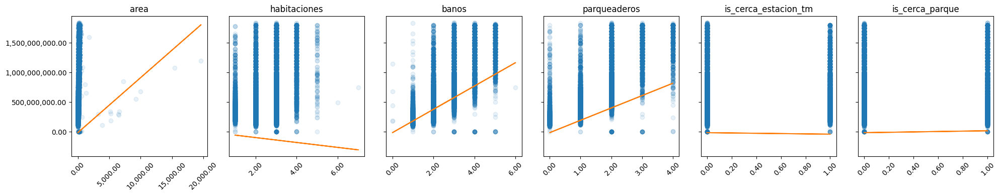

In [139]:
f, axs = plt.subplots(1, len(features), sharey=True, figsize=(20, 4))

for i in range(len(features)):
    col = features[i]
    x = X_train[col]
    m = regression.coef_[i]
    b = regression.intercept_

    axs[i].plot(x, y_train, "o", alpha=0.1)
    axs[i].plot(x, x * m + b)
    axs[i].set_title(col)
    
    # Formatear los ejes para mostrar solo dos decimales
    axs[i].xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
    axs[i].yaxis.set_major_formatter(FuncFormatter(decimal_formatter))

    # Rotar las etiquetas del eje X
    axs[i].tick_params(axis='x', labelrotation=45)  # Rota las etiquetas del eje X a 45 grados

plt.tight_layout()  # Ajustar el layout
plt.show()

In [140]:
print('MAE')
print("Train:", mean_absolute_error(y_train, regression.predict(X_train)))
print("Test :", mean_absolute_error(y_test, regression.predict(X_test)))

MAE
Train: 188226851.2523595
Test : 185418918.6444178


MAE
- Entrenamiento: aprox. 188 Millones COP
- Prueba: aprox 185 Millones COP
- Un MAE de aproximadamente 188 millones de COP en el conjunto de entrenamiento significa que, en promedio, el modelo se equivoca por esa cantidad al predecir los precios de venta de los apartamentos en los datos de entrenamiento

In [142]:
print('RMSE')
print("Train:", np.sqrt(mean_squared_error(y_train, regression.predict(X_train))))
print("Test :", np.sqrt(mean_squared_error(y_test, regression.predict(X_test))))

RMSE
Train: 253289178.4878396
Test : 249673552.8133703


MSE
- Entrenamiento: aprox 252 Millones COP
- Prueba: aprox 249 Millones COP
- El MSE de aproximadamente 252 millones de COP en el conjunto de prueba indica que el modelo tiene errores que, al ser elevados al cuadrado, contribuyen a esta cifra.


In [144]:
print('R2')
print("Train:", r2_score(y_train, regression.predict(X_train)))
print("Test :", r2_score(y_test, regression.predict(X_test)))

R2
Train: 0.6610905145495766
Test : 0.6711913557961966


### Análisis del error

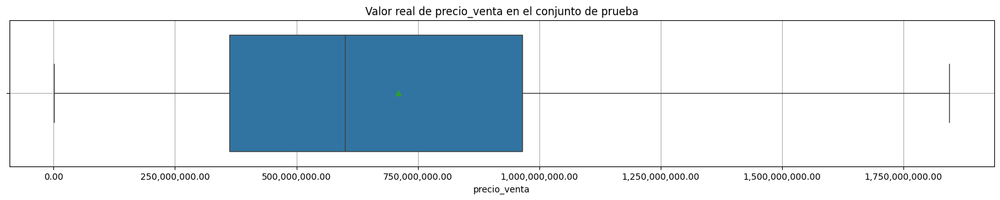

In [146]:
plt.figure(figsize=(20, 3))
sns.boxplot(x=y_test, showmeans=True, orient="h")
plt.title("Valor real de precio_venta en el conjunto de prueba")
plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))
plt.grid()
plt.show()

In [147]:
y_test.describe(percentiles=[0.25, 0.5, 0.75, 0.99])

count         4685.00
mean     709898691.11
std      435459011.58
min        1160000.00
25%      362060647.00
50%      600000000.00
75%      965000000.00
99%     1800000000.00
max     1845000000.00
Name: precio_venta, dtype: float64

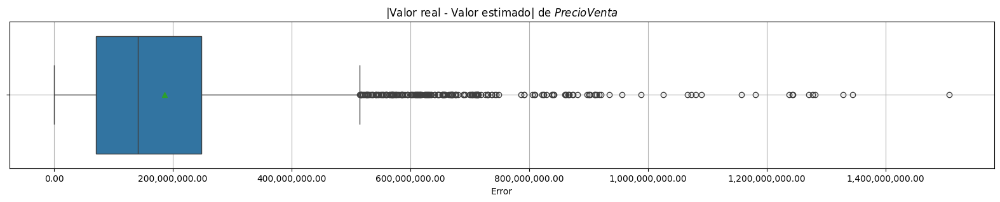

In [148]:
plt.figure(figsize=(20, 3))
sns.boxplot(x=abs(y_test - regression.predict(X_test)), showmeans=True, orient="h")
plt.title("|Valor real - Valor estimado| de $\t{Precio Venta}$")
plt.xlabel("Error")
plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter))

plt.grid()
plt.show()

In [149]:
abs(y_test-regression.predict(X_test)).describe(percentiles=[0.25, 0.5, 0.75, 0.95, 0.99])

count         4685.00
mean     185418918.64
std      167220441.74
min          62841.35
25%       70215997.72
50%      141339469.80
75%      247890391.31
95%      497436344.06
99%      808673149.27
max     1507972196.15
Name: precio_venta, dtype: float64

- La diferencia entre los errores de entrenamiento y prueba es pequeña, lo que sugiere que el modelo no está sobreajustado y tiene un rendimiento consistente en ambos conjuntos.
- El precio de venta tiene un rango considerable, con un promedio de aproximadamente 709.5 millones de COP y un valor mínimo de 1.1 millones hasta un máximo de 1.845 billones de COP. Esto significa que hay una gran variabilidad en los precios, y el modelo podría estar enfrentando dificultades para predecir correctamente precios muy altos o muy bajos.

### ROI - Retorno de inversión

In [152]:
# Parámetros del problema
costo_por_hora = 9500
horas_manual  = 6 # horas de manualidad
horas_ml = 1 # reducción de hora con modelo
num_apartamentos_mes = 500
costo_avaluo_presencial = 20_000_000  # Estimado de costo de cada avalúo presencial

# Cálculo de costos manuales
costo_total_manual = num_apartamentos_mes * horas_manual * costo_por_hora

# Cálculo de costos con ML
costo_total_ml = num_apartamentos_mes * horas_ml * costo_por_hora

# Simulación de estimaciones por debajo de 20 millones (usando el conjunto de prueba)
y_pred = regression.predict(X_test)

# y_pred Resultado de las predicciones en el conjunto de prueba
porcentaje_avaluos_adicionales = np.mean(y_pred < 20_000_000)
costo_avaluos_presenciales = porcentaje_avaluos_adicionales * num_apartamentos_mes * costo_avaluo_presencial

# Costo total con ML considerando los avalúos adicionales
costo_total_ml_con_avaluos = costo_total_ml + costo_avaluos_presenciales

# Resultados
print(f'Costo total manual mensual: COP {costo_total_manual:,.2f}')
print(f'Costo total mensual con ML sin avalúos: COP {costo_total_ml:,.2f}')
print(f'Costo adicional por avalúos presenciales: COP {costo_avaluos_presenciales:,.2f}')
print(f'Costo total mensual con ML considerando avalúos: COP {costo_total_ml_con_avaluos:,.2f}')

# Ahorro mensual comparativo
ahorro_mensual = costo_total_manual - costo_total_ml_con_avaluos
print(f'Ahorro mensual con ML: COP {ahorro_mensual:,.2f}')


Costo total manual mensual: COP 28,500,000.00
Costo total mensual con ML sin avalúos: COP 4,750,000.00
Costo adicional por avalúos presenciales: COP 0.00
Costo total mensual con ML considerando avalúos: COP 4,750,000.00
Ahorro mensual con ML: COP 23,750,000.00


## Curva ROC
([Volver al inicio](#Indice))

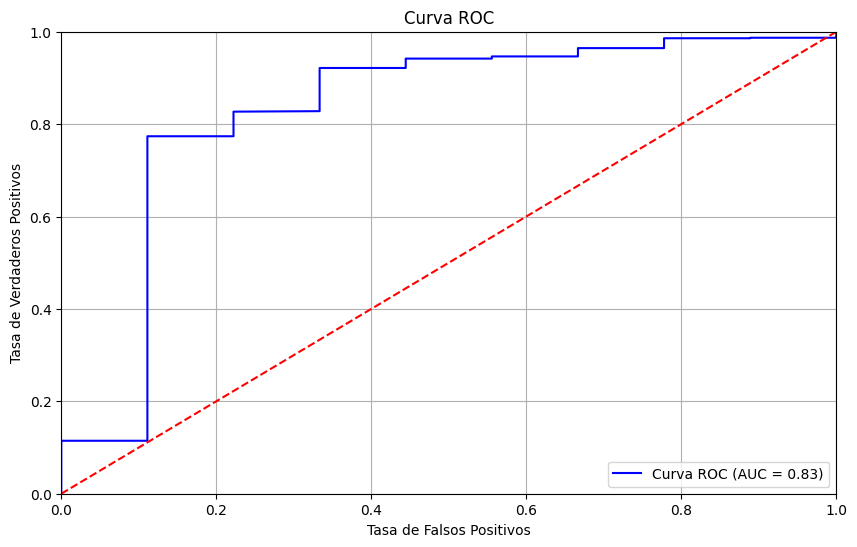

In [154]:
# Se copia el dataset con los atributos obtenidos
df = df_selected.copy()

# Crear una columna binaria para clasificar según un umbral
umbral = 20000000
df['precio_clasificacion'] = (df['precio_venta'] > umbral).astype(int)

# Seleccionar características
X = df[features] 
y = df['precio_clasificacion']

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenar el modelo con regresión logística
model = LogisticRegression()
model.fit(X_train, y_train)

# Obtener las probabilidades de las predicciones
y_prob = model.predict_proba(X_test)[:, 1]

# Calcular la curva ROC
fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

# Graficar la curva ROC
plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, color='blue', label=f'Curva ROC (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC')
plt.legend(loc='lower right')
plt.grid()
plt.show()


De acuerdo con los resultados obtenidos, se prevee que el modelo generado este con un 0.83 de acierto para que clasifique correctamente los positivos frente a los negativos.